Copyright (c) 2020 Ryan Cohn and Elizabeth Holm. All rights reserved. <br />
Licensed under the MIT License (see LICENSE for details) <br />
Written by Ryan Cohn

# Instance Segmentation of Powder Particles and Satellites

This example will take you through the process of training a model to segment powder particles and visualizing the model predictions.

In [1]:
## regular module imports
import cv2
import json
import matplotlib.pyplot as plt
import numpy as np
import os
from pathlib import Path
import pickle
import skimage.io
import sys

## detectron2
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.data import (
    DatasetCatalog,
    MetadataCatalog,
)
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.structures import BoxMode

root = '../../../'
ocean_images = root + '../../../../ocean/projects/dmr200021p/sprice/tuning/'
sys.path.append(root)

from ampis import data_utils, visualize, analyze
from ampis.applications import powder
from ampis.structures import InstanceSet
from ampis.visualize import display_iset

%matplotlib inline

# Labeling Data

The [VGG Image Annotator](http://www.robots.ox.ac.uk/~vgg/software/via/) was used to generate particle labels. The a

# Loading Data
The process for training models for powder particles and satellites is identical. Enter the corresponding value depending on which model you want to train. <br />
The paths to individual images, and all annotation data are stored in the JSON files generated by the VGG image annotator.



In [2]:
EXPERIMENT_NAME = 'satellite' # can be 'particle' or 'satellite'
json_path_train = Path('batch_jobs', 'SALAS_Rep', 'satellite_training.json')  # path to training data
json_path_val = Path('batch_jobs', 'SALAS_Rep', 'satellite_validation.json')  # path to training data
assert json_path_train.is_file(), 'training file not found!'
assert json_path_val.is_file(), 'validation file not found!'


## Registration
Detectron2 requires that datasets be registered for later use.
Registration stores the name of the dataset and a function that can be used to retrieve the image paths and labels in a format that the model can use.

In [3]:
DatasetCatalog.clear()  # resets catalog, helps prevent errors from running cells multiple times

# store names of datasets that will be registered for easier access later
dataset_train = f'{EXPERIMENT_NAME}_Train'
dataset_valid = f'{EXPERIMENT_NAME}_Val'

# register the training dataset
DatasetCatalog.register(dataset_train, lambda f = json_path_train: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                     im_root=f,  # path to the training data json file
                                                                                                     dataset_class='Train'))  # indicates this is training data
# register the validation dataset
DatasetCatalog.register(dataset_valid, lambda f = json_path_val: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                im_root=f,  # path to validation data json file
                                                                                                dataset_class='Validation'))  # indicates this is validation data
                              
print(f'Registered Datasets: {DatasetCatalog.list()}')

## There is also a metadata catalog, which stores the class names.
for d in [dataset_train, dataset_valid]:
    MetadataCatalog.get(d).set(**{'thing_classes': [EXPERIMENT_NAME]})

Registered Datasets: ['satellite_Train', 'satellite_Val']


## Verify images and annotations are loaded correctly
Also, this is a great time to admire my hand-drawn labels, which took sooooo long to do!
### Training Data

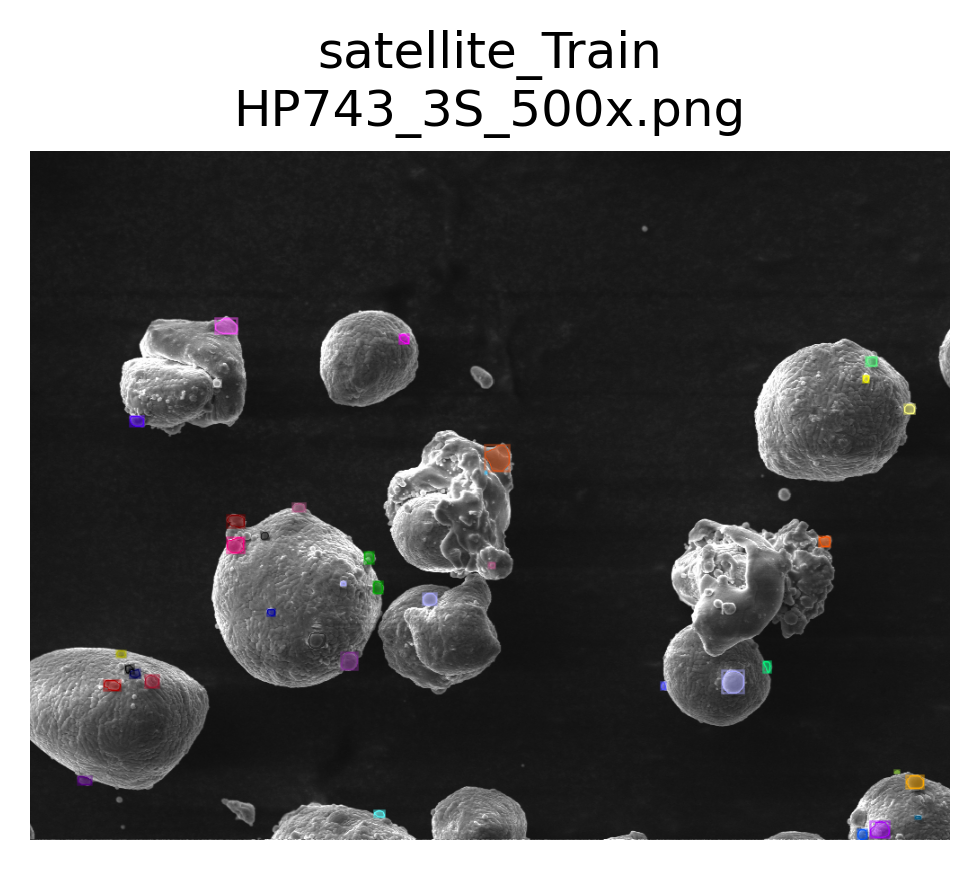

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_3S_500x.png
	num_instances: 37


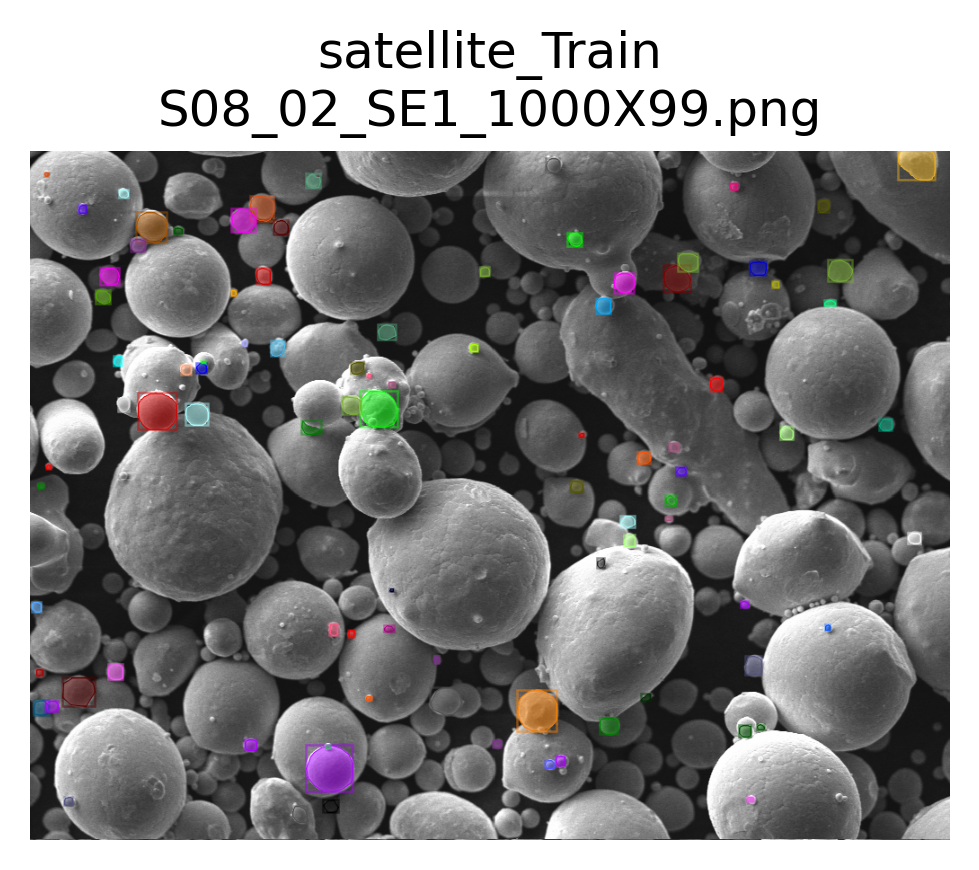

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_02_SE1_1000X99.png
	num_instances: 93


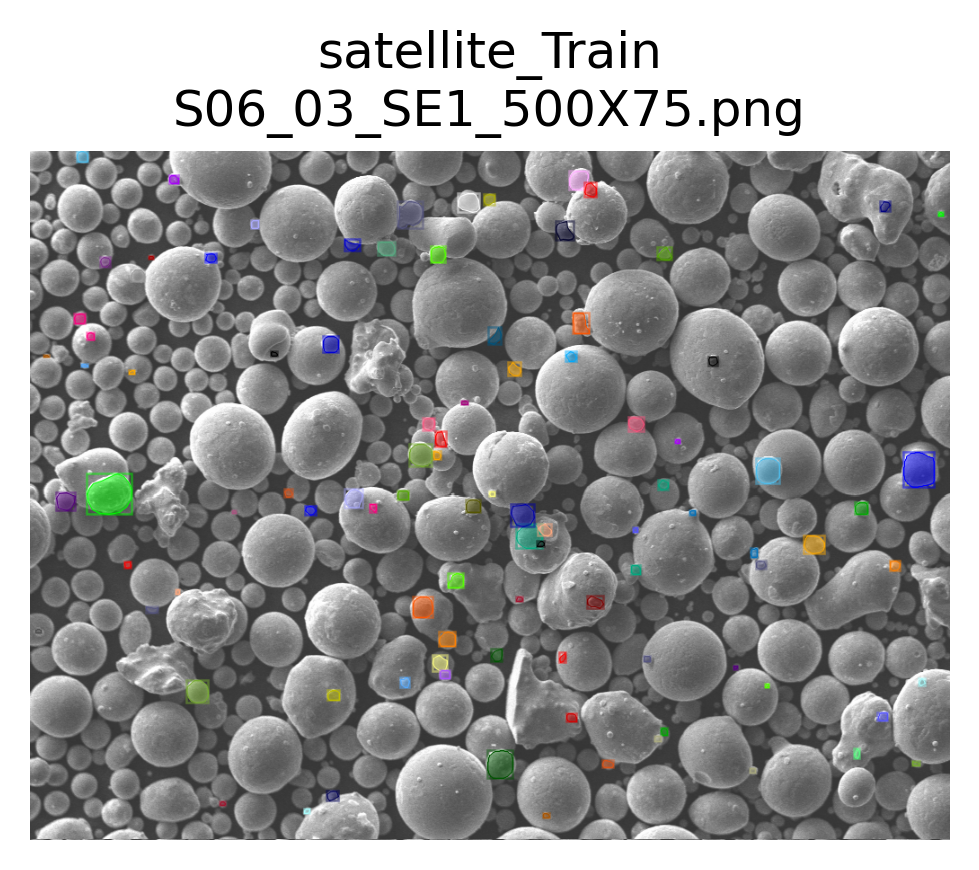

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_03_SE1_500X75.png
	num_instances: 96


In [4]:
for i in np.random.choice(DatasetCatalog.get(dataset_train), 3, replace=False):
    visualize.display_ddicts(i, None, dataset_train, suppress_labels=True)
#To view annotations on the entire dataset and not just 3 random instances, uncomment the following code
#for i in DatasetCatalog.get(dataset_train):
    #visualize.display_ddicts(i, None, dataset_train, suppress_labels=True)

### Validation Data

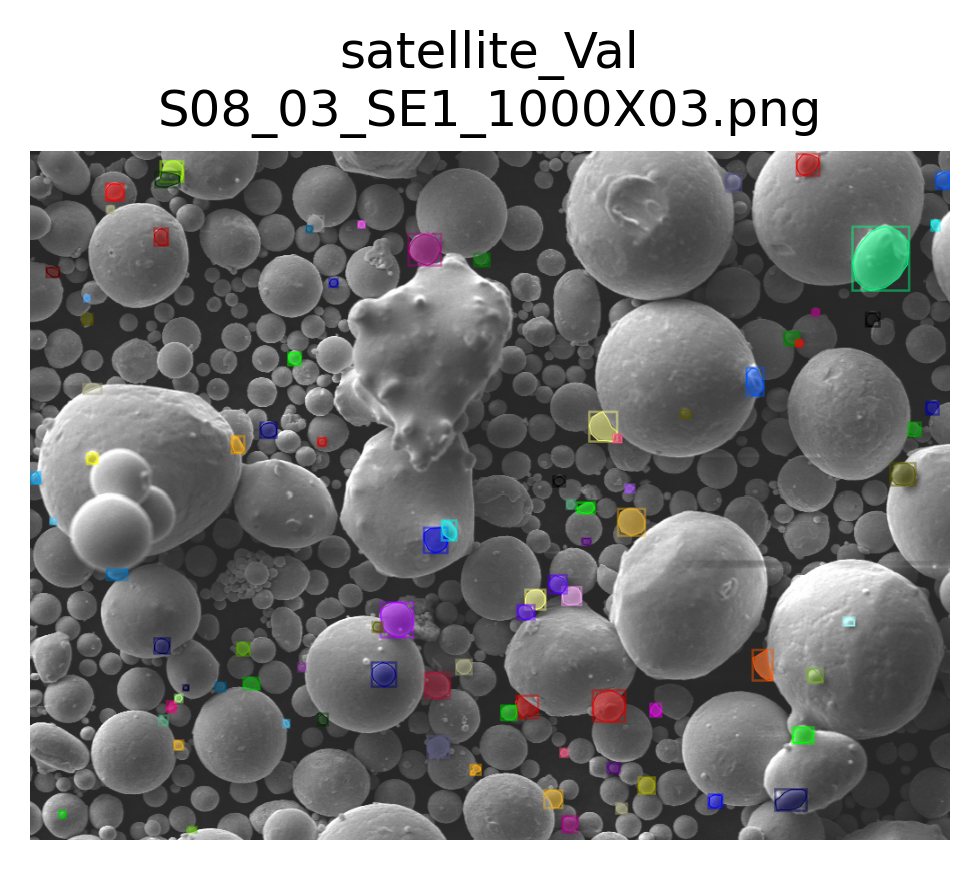

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png
	num_instances: 88


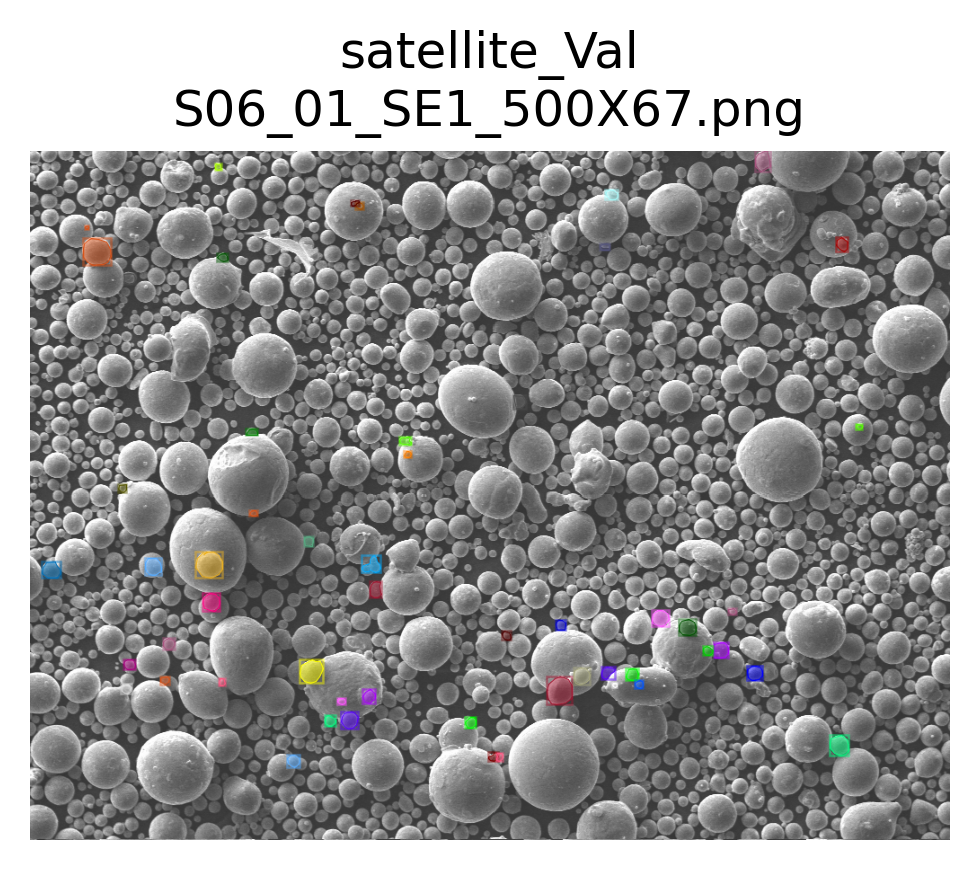

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png
	num_instances: 54


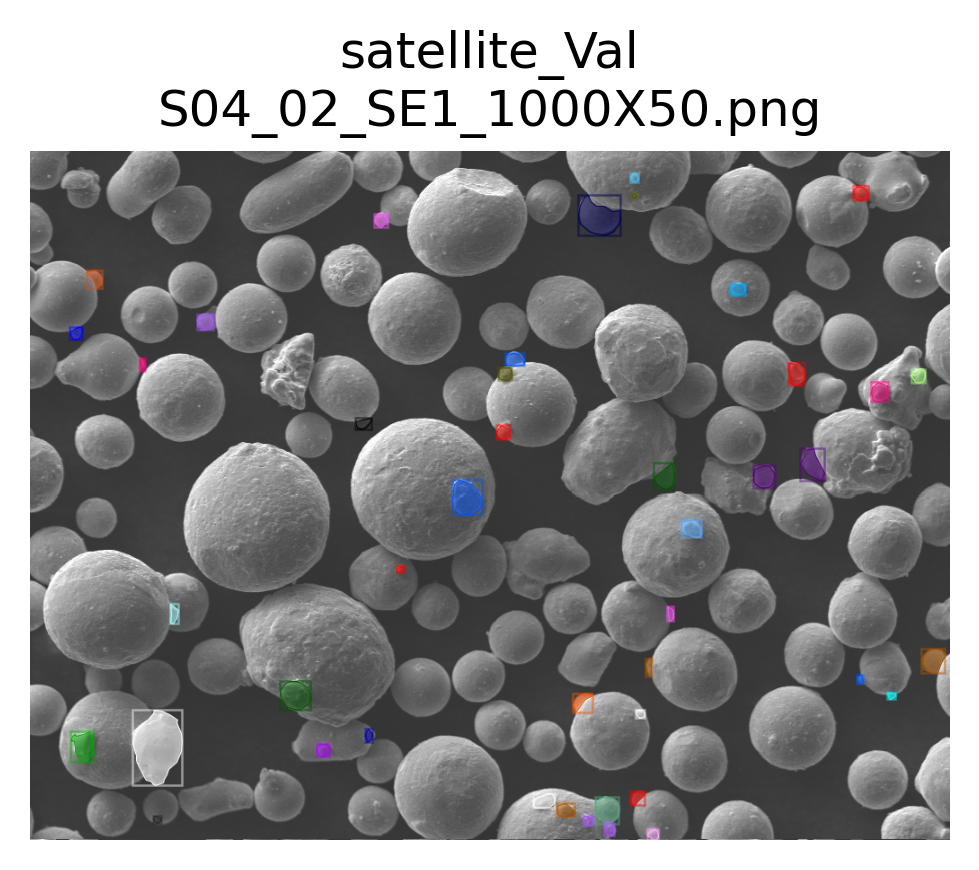

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png
	num_instances: 45


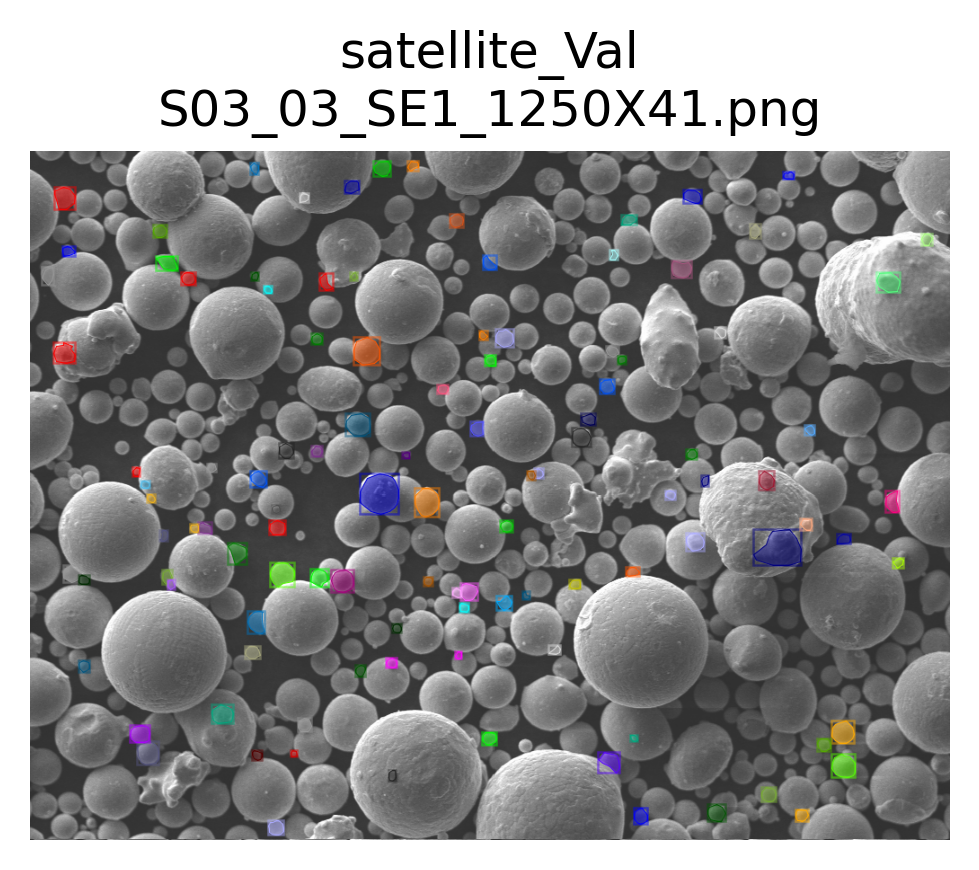

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png
	num_instances: 111


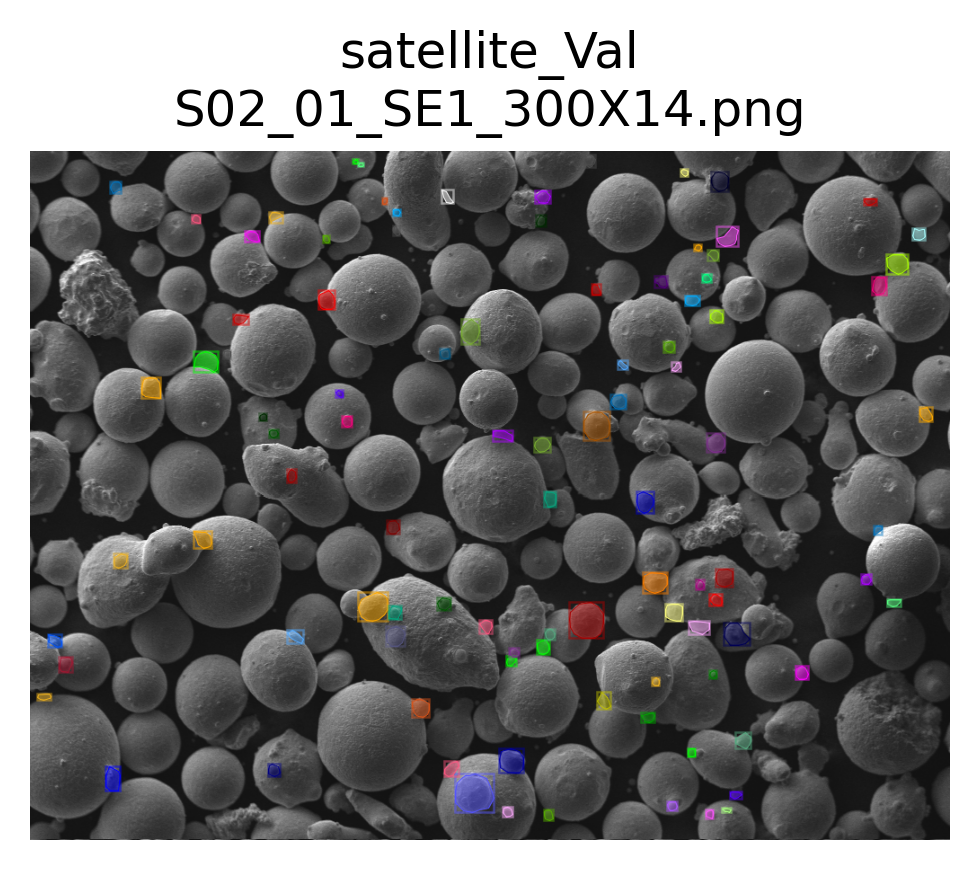

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png
	num_instances: 98


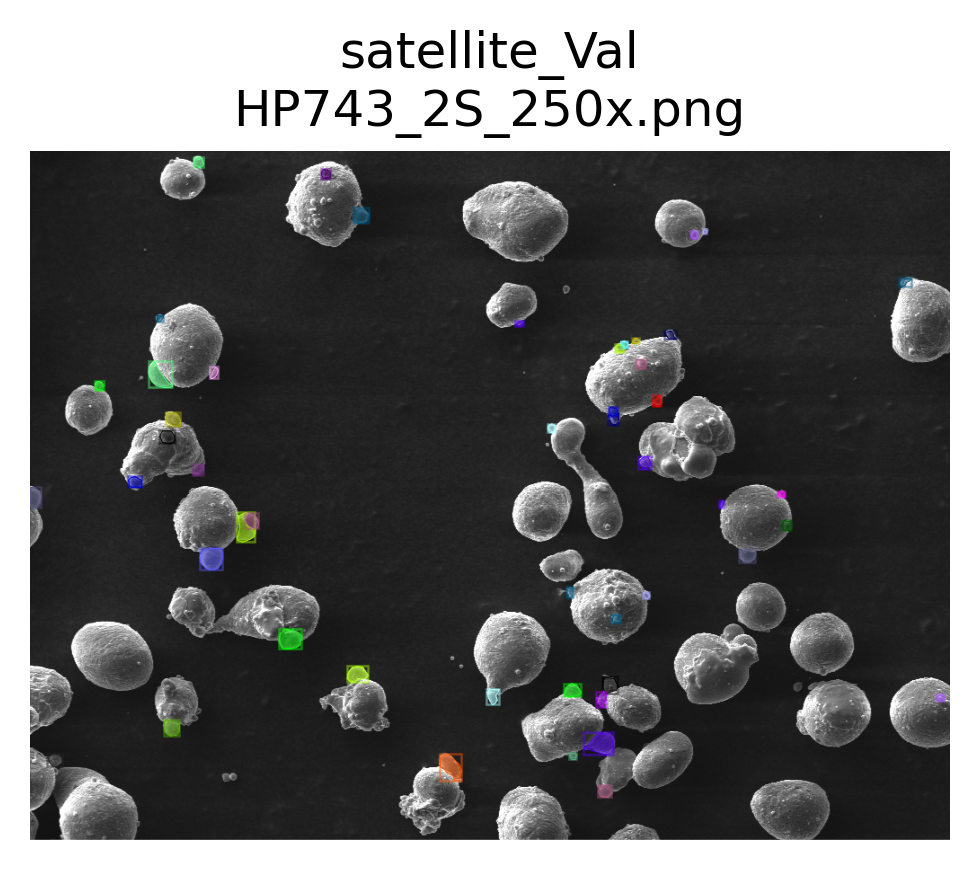

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png
	num_instances: 49


In [5]:
for i in DatasetCatalog.get(dataset_valid):
    visualize.display_ddicts(i, None, dataset_valid, suppress_labels=True)

## Model Configuration
This is where we specify the directory where the outputs are saved, various hyperparameters for the model, and more.

In [6]:
cfg = get_cfg() # initialize cfg object
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'))  # load default parameters for Mask R-CNN
cfg.INPUT.MASK_FORMAT = 'polygon'  # masks generated in VGG image annotator are polygons
cfg.DATASETS.TRAIN = (dataset_train,)  # dataset used for training model
cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # we will look at the predictions on both sets after training
cfg.SOLVER.IMS_PER_BATCH = 1 # number of images per batch (across all machines)
cfg.SOLVER.CHECKPOINT_PERIOD = 1000  # number of iterations after which to save model checkpoints
cfg.MODEL.DEVICE='cuda'  # 'cpu' to force model to run on cpu, 'cuda' if you have a compatible gpu
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 # Since we are training separate models for particles and satellites there is only one class output
cfg.TEST.DETECTIONS_PER_IMAGE = 400 if EXPERIMENT_NAME == 'particle' else 250  # maximum number of instances that can be detected in an image (this is fixed in mask r-cnn)
cfg.SOLVER.MAX_ITER = 5000  # maximum number of iterations to run during training
                            # Increasing this may improve the training results, but will take longer to run (especially without a gpu!)
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.PANOPTIC_FPN.COMBINE.INSTANCES_CONFIDENCE_THRESH = 0.5
# model weights will be downloaded if they are not present
weights_path = Path('..','models','model_final_f10217.pkl')
if weights_path.is_file():
    print('Using locally stored weights: {}'.format(weights_path))
else:
    weights_path = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
    print('Weights not found, weights will be downloaded from source: {}'.format(weights_path))
cfg.MODEL.WEIGHTs = str(weights_path)
cfg.OUTPUT_DIR = str(Path('DEMO_TEST'))
# make the output directory
os.makedirs(Path(cfg.OUTPUT_DIR), exist_ok=True)

Weights not found, weights will be downloaded from source: https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl


In [7]:
print('--------------------------------')
print(cfg.SOLVER.BASE_LR)
print(cfg.SOLVER.WEIGHT_DECAY)
print(cfg.MODEL.RETINANET.SCORE_THRESH_TEST)
print(cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST)
print(cfg.MODEL.PANOPTIC_FPN.COMBINE.INSTANCES_CONFIDENCE_THRESH)
print(cfg.MODEL.ROI_HEADS.NUM_CLASSES)
print(cfg.SOLVER.IMS_PER_BATCH) 

--------------------------------
0.02
0.0001
0.5
0.5
0.5
1
1


# Model Training
Once we have everything set up, training is very easy!

Note- this block will generate a huge wall of text.

In [12]:
trainer = DefaultTrainer(cfg)  # create trainer object from cfg
trainer.resume_or_load(resume=False)  # start training from iteration 0
trainer.train()  # train the model!

[09/16 18:15:36 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[09/16 18:15:36 d2.data.build]: Removed 0 images with no usable annotations. 20 images left.
[09/16 18:15:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[09/16 18:15:36 d2.data.build]: Using training sampler TrainingSampler
[09/16 18:15:36 d2.data.common]: Serializing 20 elements to byte tensors and concatenating them all ...
[09/16 18:15:36 d2.data.common]: Serialized dataset takes 0.46 MiB
WARNING [09/16 18:15:36 d2.solver.build]: SOLVER.STEPS contains values larger than SOLVER.MAX_ITER. These values will be ignored.
[09/16 18:15:37 d2.engine.train_loop]: Starting training from iteration 0
[09/16 18:15:42 d2.utils.events]:  eta: 0:12:43  iter: 19  total_loss: 0.97  loss_cls: 0.1379  loss_box_reg: 0.3073  loss_mask: 0.1473  loss_rpn_cls: 0.08605  loss_rpn_loc: 0.2708  time: 0.1526  data_time: 0.1005  lr: 0.00039962  max_mem: 1879M
[09/

[09/16 18:17:08 d2.utils.events]:  eta: 0:10:49  iter: 599  total_loss: 0.8426  loss_cls: 0.1178  loss_box_reg: 0.2873  loss_mask: 0.1317  loss_rpn_cls: 0.06554  loss_rpn_loc: 0.2225  time: 0.1484  data_time: 0.0152  lr: 0.011988  max_mem: 1991M
[09/16 18:17:11 d2.utils.events]:  eta: 0:10:46  iter: 619  total_loss: 0.7763  loss_cls: 0.1115  loss_box_reg: 0.2691  loss_mask: 0.1351  loss_rpn_cls: 0.05777  loss_rpn_loc: 0.2005  time: 0.1485  data_time: 0.0153  lr: 0.012388  max_mem: 1991M
[09/16 18:17:14 d2.utils.events]:  eta: 0:10:43  iter: 639  total_loss: 0.785  loss_cls: 0.1043  loss_box_reg: 0.2753  loss_mask: 0.1317  loss_rpn_cls: 0.05564  loss_rpn_loc: 0.1989  time: 0.1484  data_time: 0.0163  lr: 0.012787  max_mem: 1991M
[09/16 18:17:17 d2.utils.events]:  eta: 0:10:40  iter: 659  total_loss: 0.7745  loss_cls: 0.1074  loss_box_reg: 0.2672  loss_mask: 0.1346  loss_rpn_cls: 0.06927  loss_rpn_loc: 0.2092  time: 0.1484  data_time: 0.0163  lr: 0.013187  max_mem: 1991M
[09/16 18:17:20 d

[09/16 18:18:47 d2.utils.events]:  eta: 0:09:12  iter: 1259  total_loss: 0.8998  loss_cls: 0.1248  loss_box_reg: 0.2843  loss_mask: 0.141  loss_rpn_cls: 0.09534  loss_rpn_loc: 0.2649  time: 0.1485  data_time: 0.0163  lr: 0.02  max_mem: 1991M
[09/16 18:18:50 d2.utils.events]:  eta: 0:09:09  iter: 1279  total_loss: 0.9823  loss_cls: 0.123  loss_box_reg: 0.3033  loss_mask: 0.1563  loss_rpn_cls: 0.1041  loss_rpn_loc: 0.3054  time: 0.1485  data_time: 0.0160  lr: 0.02  max_mem: 1991M
[09/16 18:18:53 d2.utils.events]:  eta: 0:09:06  iter: 1299  total_loss: 0.947  loss_cls: 0.1273  loss_box_reg: 0.2961  loss_mask: 0.1451  loss_rpn_cls: 0.08017  loss_rpn_loc: 0.3082  time: 0.1484  data_time: 0.0158  lr: 0.02  max_mem: 1991M
[09/16 18:18:56 d2.utils.events]:  eta: 0:09:03  iter: 1319  total_loss: 0.9247  loss_cls: 0.1286  loss_box_reg: 0.2956  loss_mask: 0.1473  loss_rpn_cls: 0.07914  loss_rpn_loc: 0.2768  time: 0.1484  data_time: 0.0152  lr: 0.02  max_mem: 1991M
[09/16 18:18:59 d2.utils.events]

[09/16 18:20:25 d2.utils.events]:  eta: 0:07:32  iter: 1919  total_loss: 0.9237  loss_cls: 0.1294  loss_box_reg: 0.2994  loss_mask: 0.1493  loss_rpn_cls: 0.0852  loss_rpn_loc: 0.2732  time: 0.1483  data_time: 0.0158  lr: 0.02  max_mem: 1991M
[09/16 18:20:28 d2.utils.events]:  eta: 0:07:29  iter: 1939  total_loss: 0.891  loss_cls: 0.1234  loss_box_reg: 0.2903  loss_mask: 0.1351  loss_rpn_cls: 0.05953  loss_rpn_loc: 0.2604  time: 0.1483  data_time: 0.0160  lr: 0.02  max_mem: 1991M
[09/16 18:20:31 d2.utils.events]:  eta: 0:07:27  iter: 1959  total_loss: 0.9081  loss_cls: 0.1226  loss_box_reg: 0.2965  loss_mask: 0.141  loss_rpn_cls: 0.07024  loss_rpn_loc: 0.2374  time: 0.1483  data_time: 0.0152  lr: 0.02  max_mem: 1991M
[09/16 18:20:34 d2.utils.events]:  eta: 0:07:24  iter: 1979  total_loss: 0.8966  loss_cls: 0.1279  loss_box_reg: 0.301  loss_mask: 0.1357  loss_rpn_cls: 0.06519  loss_rpn_loc: 0.2426  time: 0.1483  data_time: 0.0160  lr: 0.02  max_mem: 1991M
[09/16 18:20:38 d2.utils.events]

[09/16 18:22:03 d2.utils.events]:  eta: 0:05:56  iter: 2579  total_loss: 0.8575  loss_cls: 0.1241  loss_box_reg: 0.2654  loss_mask: 0.1302  loss_rpn_cls: 0.05931  loss_rpn_loc: 0.242  time: 0.1480  data_time: 0.0151  lr: 0.02  max_mem: 1991M
[09/16 18:22:06 d2.utils.events]:  eta: 0:05:52  iter: 2599  total_loss: 0.8837  loss_cls: 0.1256  loss_box_reg: 0.2751  loss_mask: 0.1354  loss_rpn_cls: 0.08301  loss_rpn_loc: 0.2407  time: 0.1479  data_time: 0.0160  lr: 0.02  max_mem: 1991M
[09/16 18:22:09 d2.utils.events]:  eta: 0:05:49  iter: 2619  total_loss: 0.8828  loss_cls: 0.1083  loss_box_reg: 0.2766  loss_mask: 0.1373  loss_rpn_cls: 0.08445  loss_rpn_loc: 0.2663  time: 0.1479  data_time: 0.0150  lr: 0.02  max_mem: 1991M
[09/16 18:22:12 d2.utils.events]:  eta: 0:05:46  iter: 2639  total_loss: 0.8868  loss_cls: 0.1104  loss_box_reg: 0.2783  loss_mask: 0.1323  loss_rpn_cls: 0.09637  loss_rpn_loc: 0.2705  time: 0.1479  data_time: 0.0154  lr: 0.02  max_mem: 1991M
[09/16 18:22:15 d2.utils.even

[09/16 18:23:41 d2.utils.events]:  eta: 0:04:17  iter: 3239  total_loss: 0.9802  loss_cls: 0.1322  loss_box_reg: 0.2887  loss_mask: 0.1372  loss_rpn_cls: 0.1282  loss_rpn_loc: 0.2696  time: 0.1478  data_time: 0.0158  lr: 0.02  max_mem: 1991M
[09/16 18:23:44 d2.utils.events]:  eta: 0:04:14  iter: 3259  total_loss: 0.8416  loss_cls: 0.1225  loss_box_reg: 0.2639  loss_mask: 0.1293  loss_rpn_cls: 0.08002  loss_rpn_loc: 0.2492  time: 0.1478  data_time: 0.0154  lr: 0.02  max_mem: 1991M
[09/16 18:23:47 d2.utils.events]:  eta: 0:04:11  iter: 3279  total_loss: 0.8894  loss_cls: 0.1339  loss_box_reg: 0.2915  loss_mask: 0.138  loss_rpn_cls: 0.06889  loss_rpn_loc: 0.2516  time: 0.1478  data_time: 0.0155  lr: 0.02  max_mem: 1991M
[09/16 18:23:50 d2.utils.events]:  eta: 0:04:08  iter: 3299  total_loss: 0.837  loss_cls: 0.1092  loss_box_reg: 0.2604  loss_mask: 0.128  loss_rpn_cls: 0.07316  loss_rpn_loc: 0.25  time: 0.1478  data_time: 0.0160  lr: 0.02  max_mem: 1991M
[09/16 18:23:53 d2.utils.events]: 

[09/16 18:25:19 d2.utils.events]:  eta: 0:02:40  iter: 3899  total_loss: 0.8015  loss_cls: 0.1141  loss_box_reg: 0.256  loss_mask: 0.1257  loss_rpn_cls: 0.07113  loss_rpn_loc: 0.2367  time: 0.1477  data_time: 0.0160  lr: 0.02  max_mem: 1991M
[09/16 18:25:22 d2.utils.events]:  eta: 0:02:37  iter: 3919  total_loss: 0.7849  loss_cls: 0.1094  loss_box_reg: 0.2554  loss_mask: 0.1203  loss_rpn_cls: 0.05502  loss_rpn_loc: 0.2154  time: 0.1478  data_time: 0.0156  lr: 0.02  max_mem: 1991M
[09/16 18:25:25 d2.utils.events]:  eta: 0:02:35  iter: 3939  total_loss: 0.8133  loss_cls: 0.102  loss_box_reg: 0.2664  loss_mask: 0.1278  loss_rpn_cls: 0.06351  loss_rpn_loc: 0.2162  time: 0.1478  data_time: 0.0153  lr: 0.02  max_mem: 1991M
[09/16 18:25:28 d2.utils.events]:  eta: 0:02:32  iter: 3959  total_loss: 0.8135  loss_cls: 0.1123  loss_box_reg: 0.2629  loss_mask: 0.1257  loss_rpn_cls: 0.07652  loss_rpn_loc: 0.2274  time: 0.1478  data_time: 0.0159  lr: 0.02  max_mem: 1991M
[09/16 18:25:31 d2.utils.event

[09/16 18:26:58 d2.utils.events]:  eta: 0:01:04  iter: 4559  total_loss: 0.7973  loss_cls: 0.1051  loss_box_reg: 0.2619  loss_mask: 0.1241  loss_rpn_cls: 0.0659  loss_rpn_loc: 0.2289  time: 0.1477  data_time: 0.0155  lr: 0.02  max_mem: 1991M
[09/16 18:27:00 d2.utils.events]:  eta: 0:01:01  iter: 4579  total_loss: 0.8044  loss_cls: 0.1179  loss_box_reg: 0.2707  loss_mask: 0.1223  loss_rpn_cls: 0.0692  loss_rpn_loc: 0.2415  time: 0.1477  data_time: 0.0150  lr: 0.02  max_mem: 1991M
[09/16 18:27:03 d2.utils.events]:  eta: 0:00:59  iter: 4599  total_loss: 0.7762  loss_cls: 0.1138  loss_box_reg: 0.2498  loss_mask: 0.1275  loss_rpn_cls: 0.05933  loss_rpn_loc: 0.2295  time: 0.1477  data_time: 0.0160  lr: 0.02  max_mem: 1991M
[09/16 18:27:06 d2.utils.events]:  eta: 0:00:56  iter: 4619  total_loss: 0.7695  loss_cls: 0.09892  loss_box_reg: 0.2559  loss_mask: 0.1201  loss_rpn_cls: 0.05791  loss_rpn_loc: 0.2101  time: 0.1477  data_time: 0.0146  lr: 0.02  max_mem: 1991M
[09/16 18:27:09 d2.utils.even

# Creating Predictor Object
We can create a predictor object with the configurations established above and the weights that were just created

In [15]:
model_checkpoints = sorted(Path(cfg.OUTPUT_DIR).glob('*.pth'))  # paths to weights saved druing training
cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # predictor requires this field to not be empty
cfg.MODEL.WEIGHTS = str(model_checkpoints[-1])  # use the last model checkpoint saved during training. If you want to see the performance of other checkpoints you can select a different index from model_checkpoints.

predictor = DefaultPredictor(cfg)  # create predictor object

# Visualizing model predictions


We can view predictions on the entire train and validation set

Dataset: satellite_Train
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_4S_500x.png


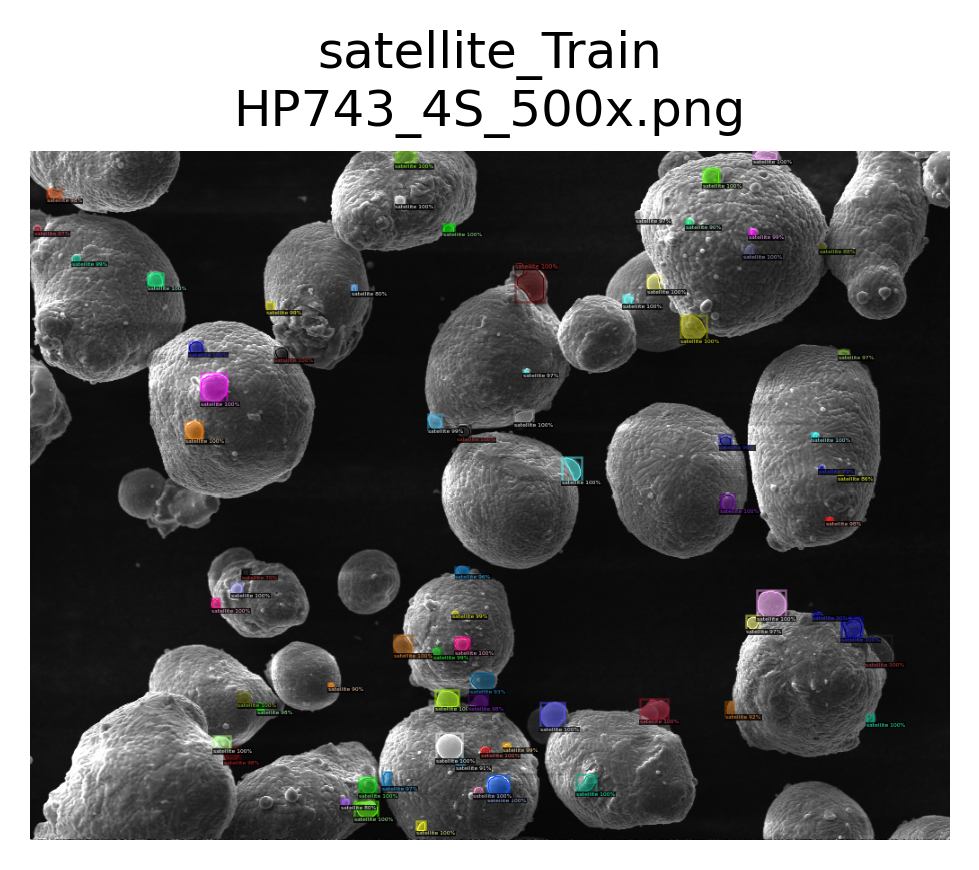

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_4S_500x.png
	num_instances: 73
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_500x.png


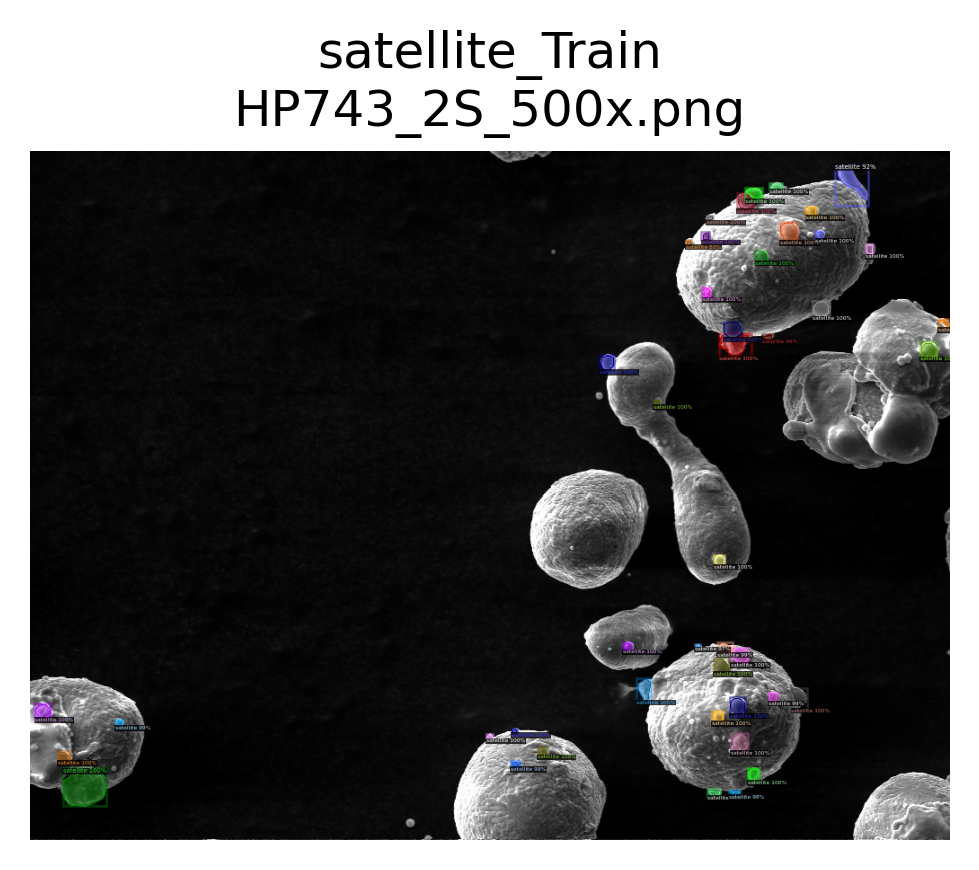

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_500x.png
	num_instances: 44
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_500x.png


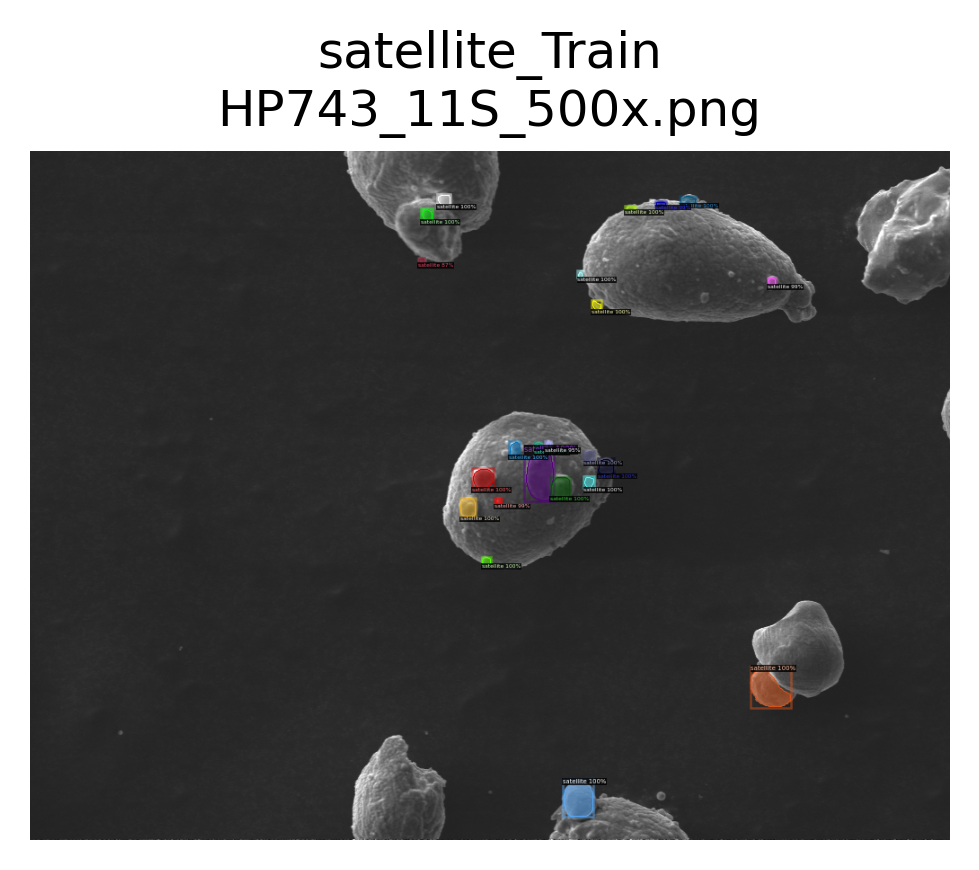

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_500x.png
	num_instances: 23
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_10S_500x.png


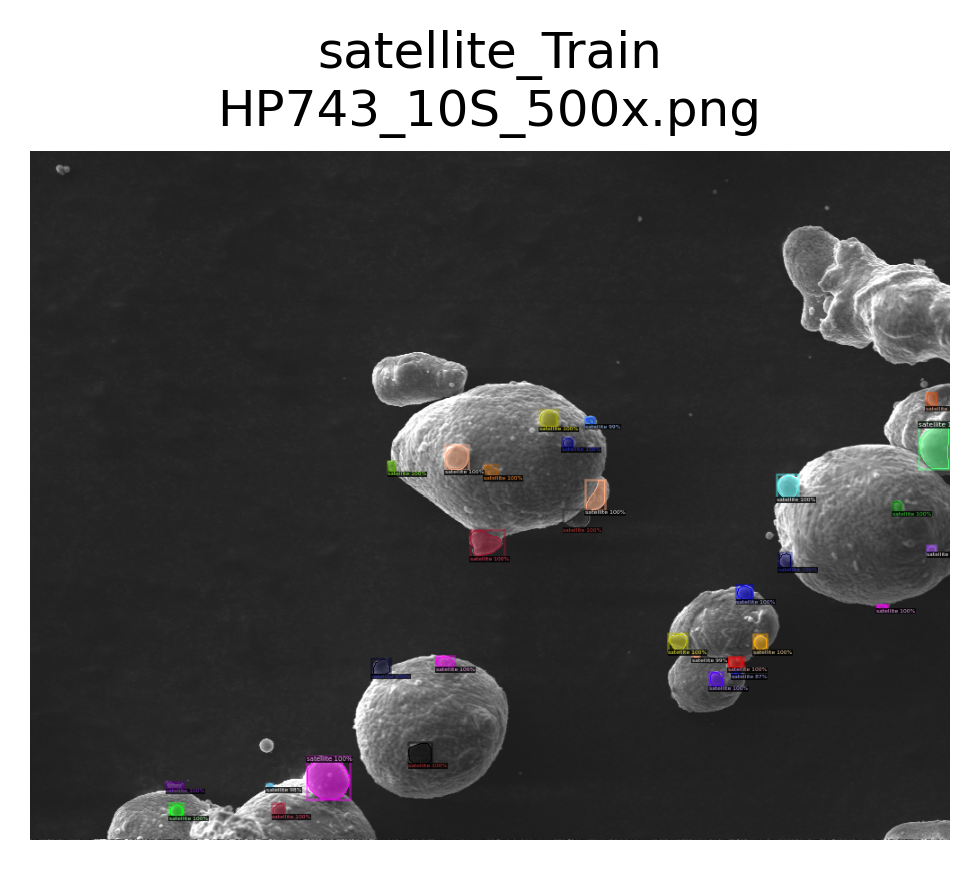

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_10S_500x.png
	num_instances: 31
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_12S_500x.png


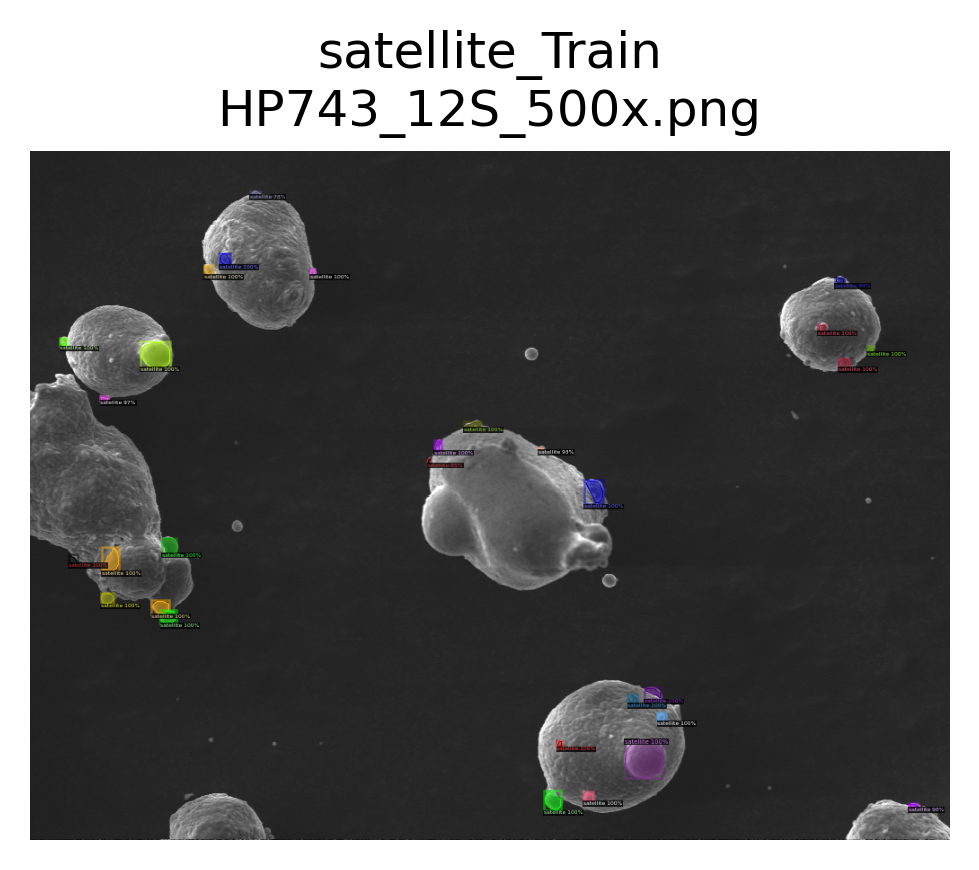

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_12S_500x.png
	num_instances: 30
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_3S_500x.png


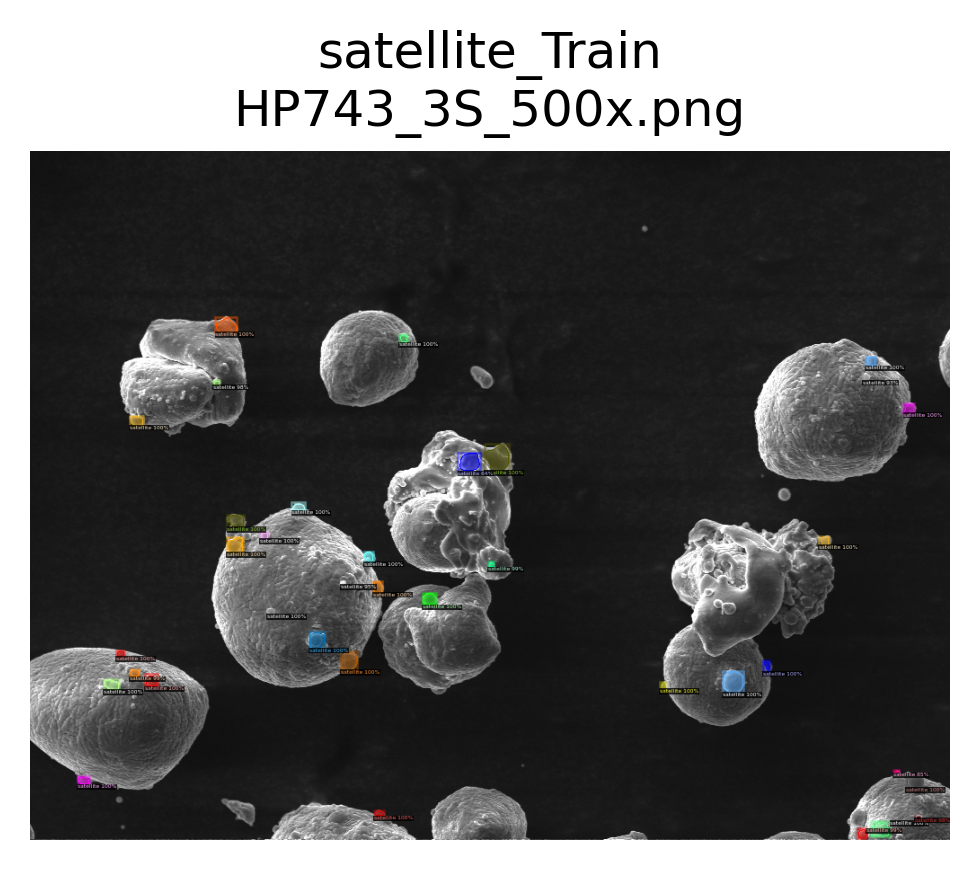

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_3S_500x.png
	num_instances: 36
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_1S_500x.png


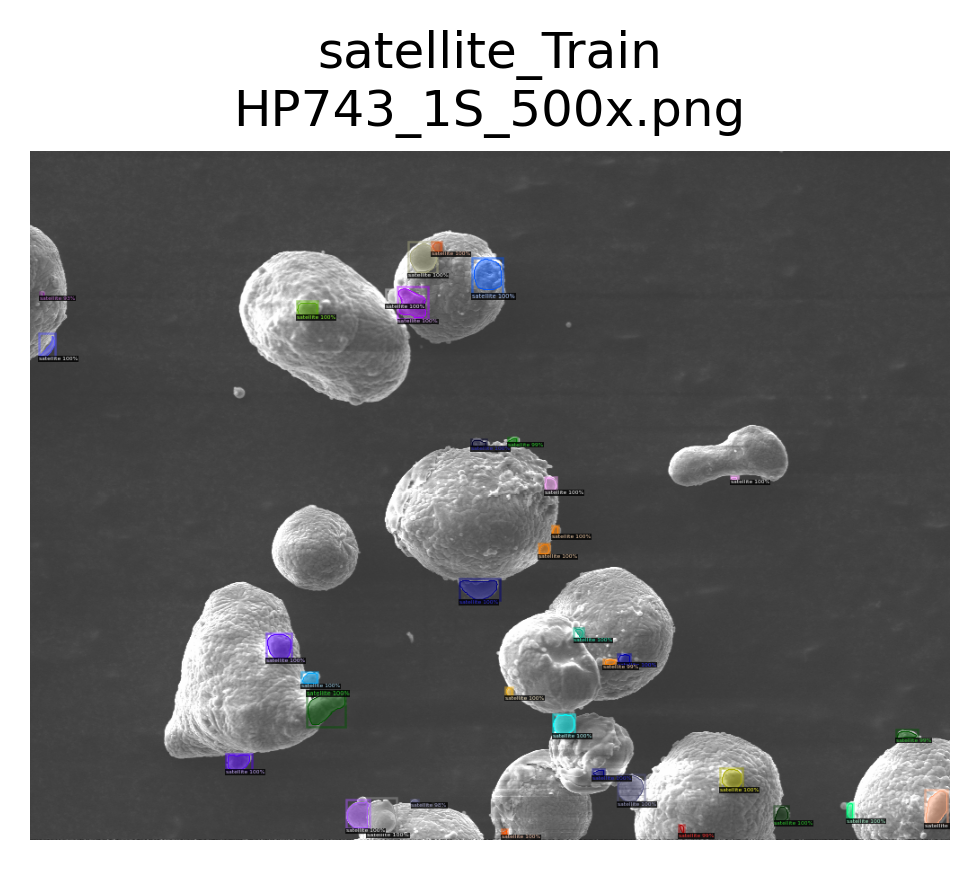

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_1S_500x.png
	num_instances: 36
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_5S_500x.png


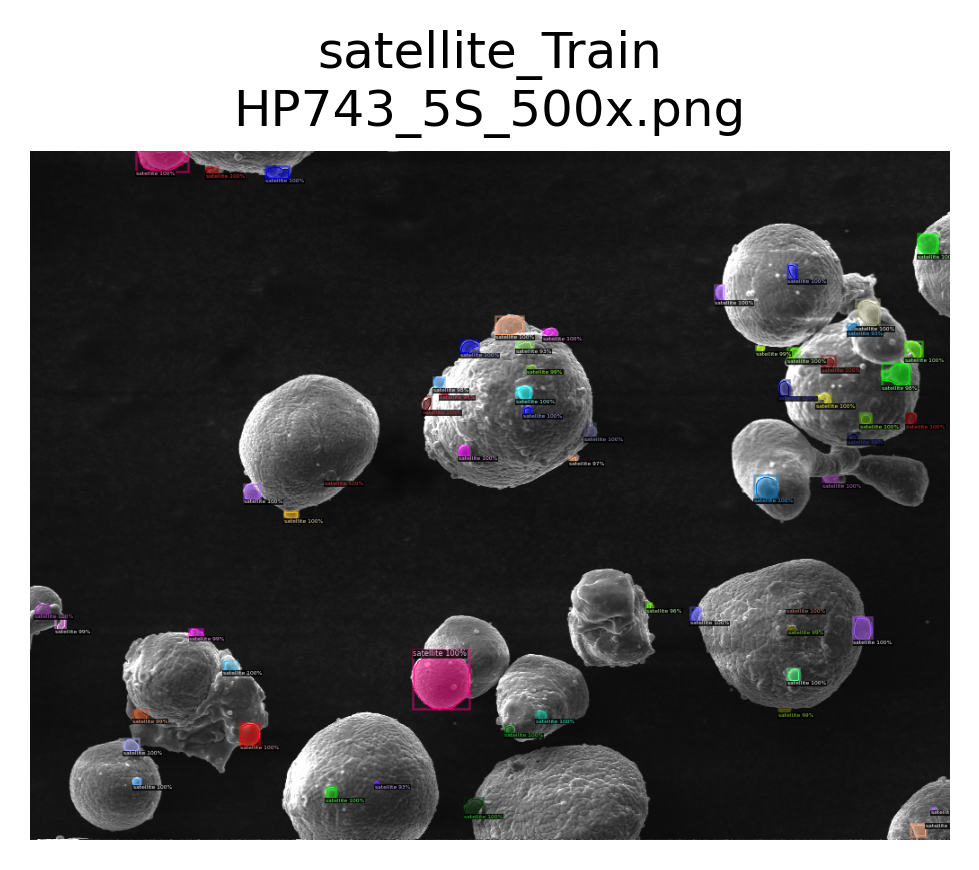

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_5S_500x.png
	num_instances: 59
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_02_SE1_1250X35.png


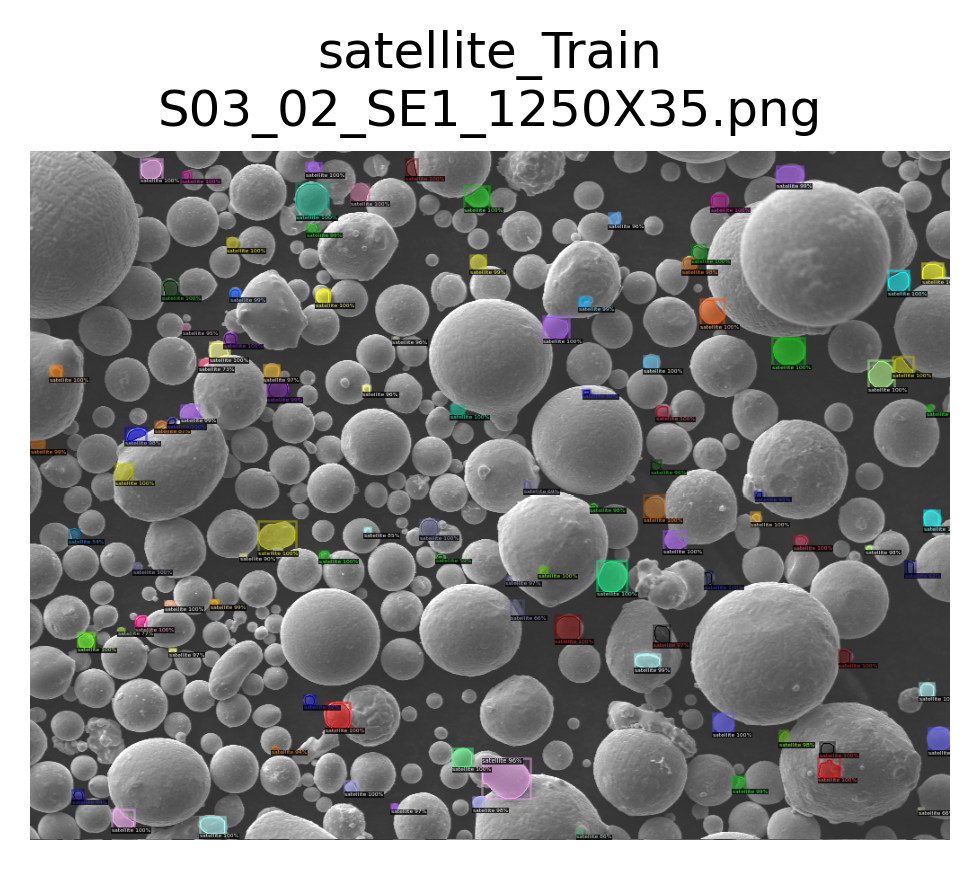

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_02_SE1_1250X35.png
	num_instances: 100
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_01_SE1_1250X28.png


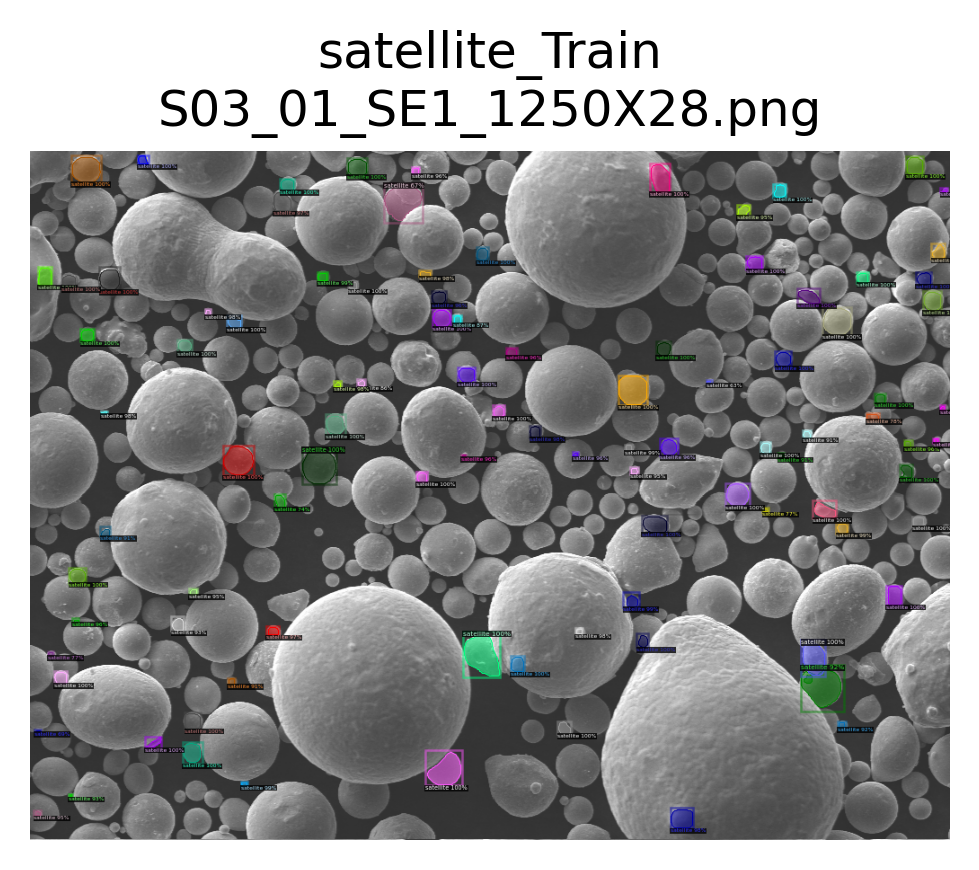

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_01_SE1_1250X28.png
	num_instances: 97
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_02_SE1_500X71.png


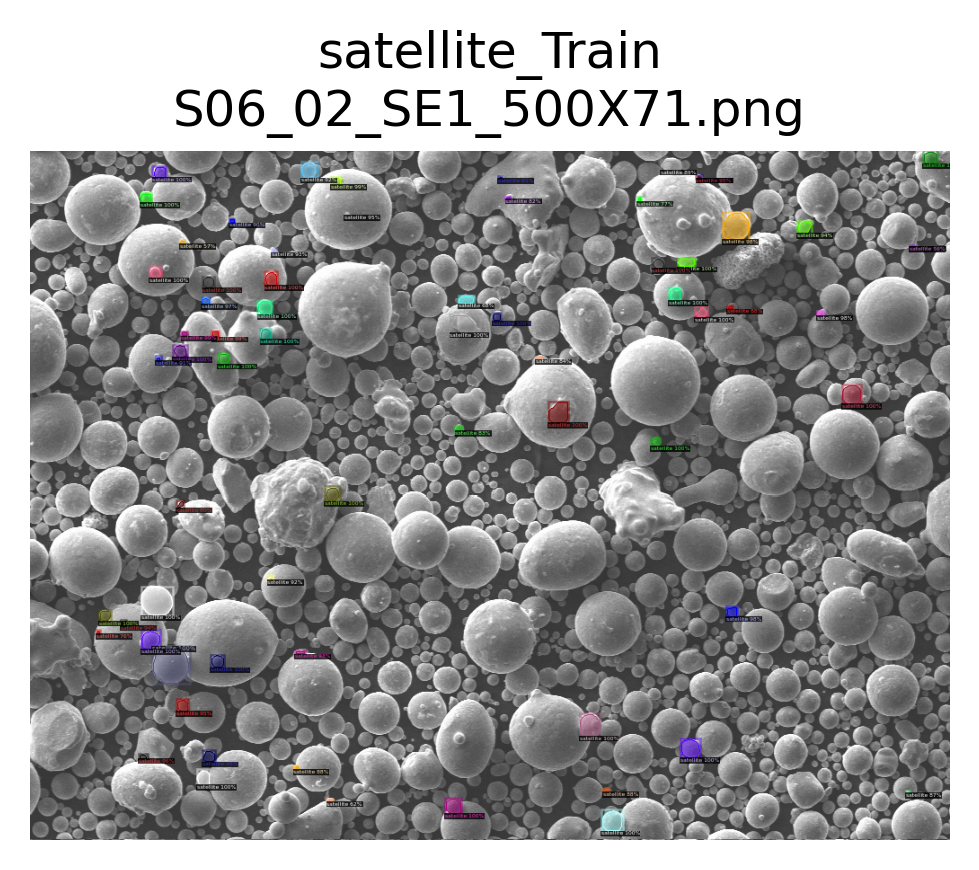

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_02_SE1_500X71.png
	num_instances: 68
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_03_SE1_500X75.png


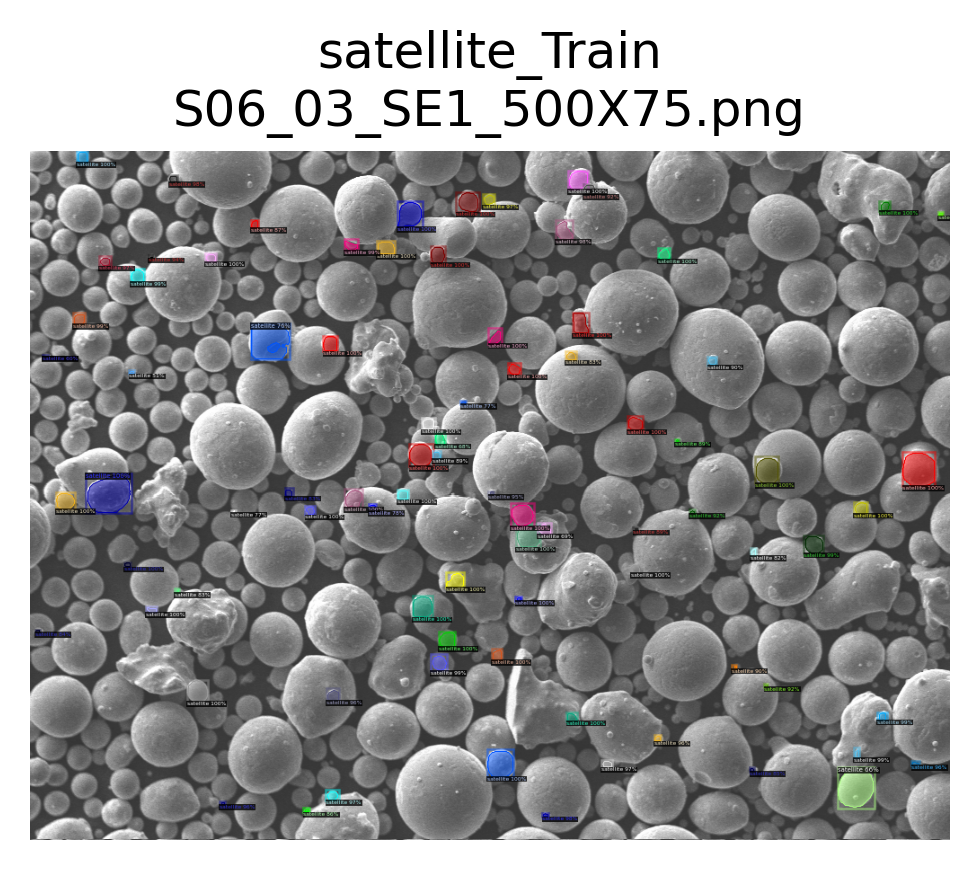

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_03_SE1_500X75.png
	num_instances: 84
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_02_SE1_300X18.png


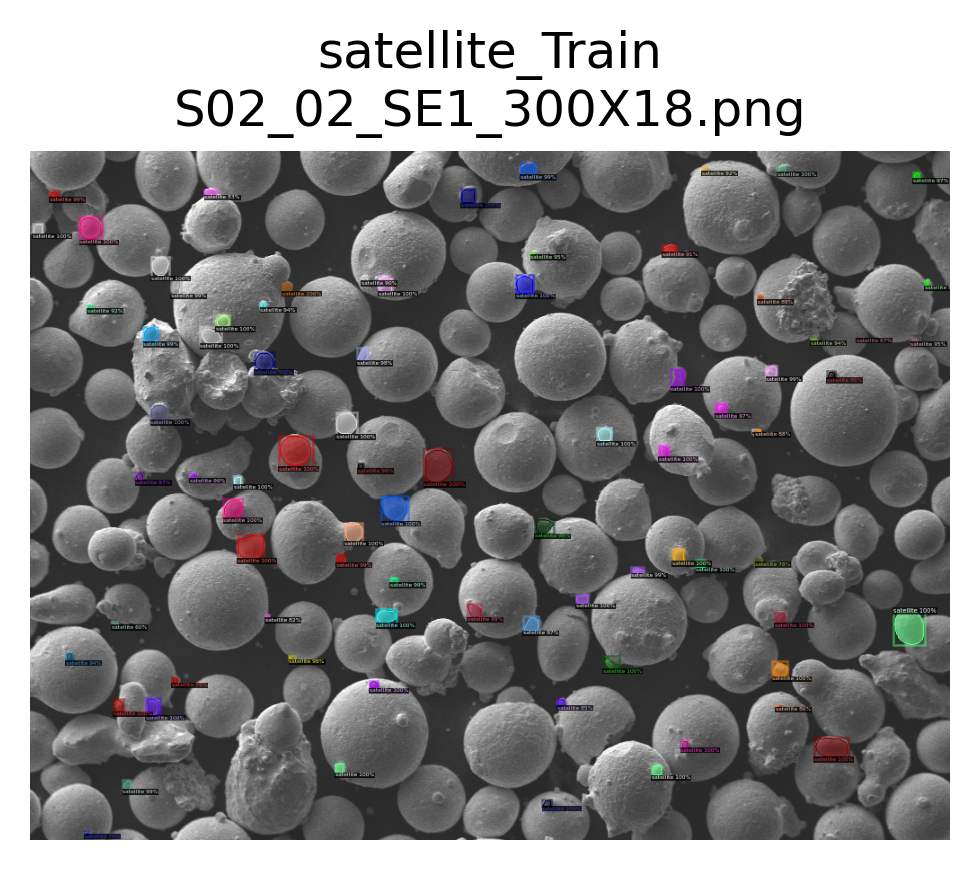

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_02_SE1_300X18.png
	num_instances: 81
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_03_SE1_300X22.png


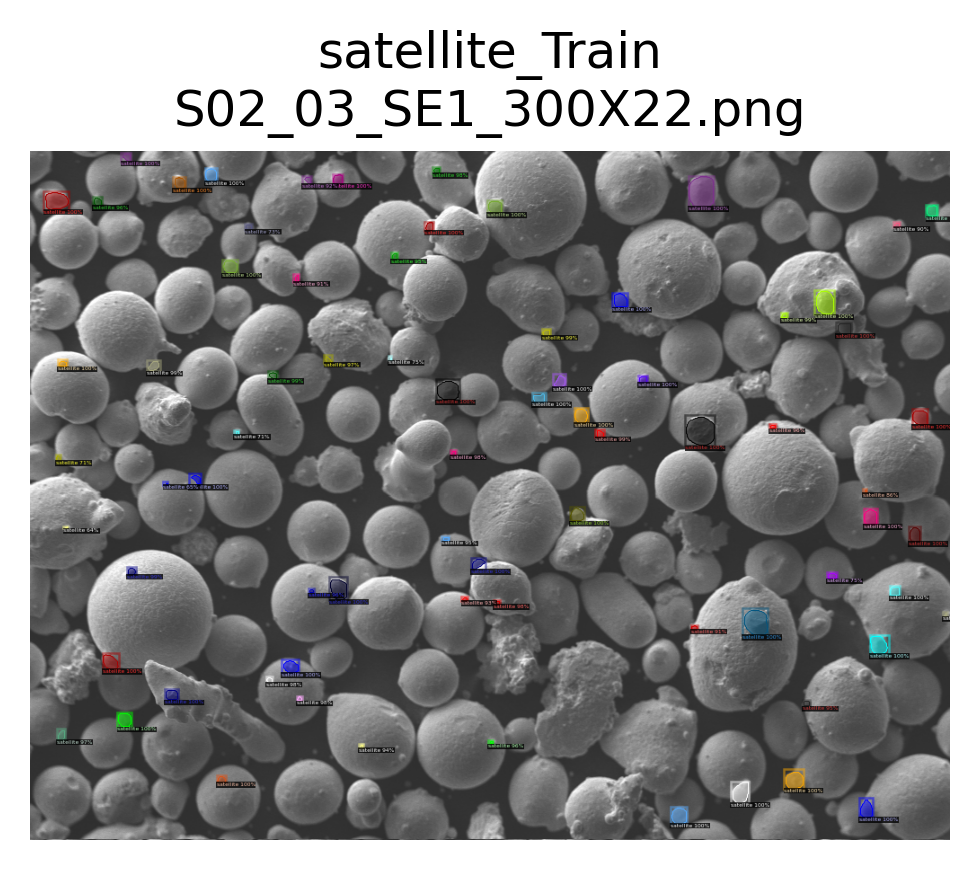

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_03_SE1_300X22.png
	num_instances: 74
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_250x.png


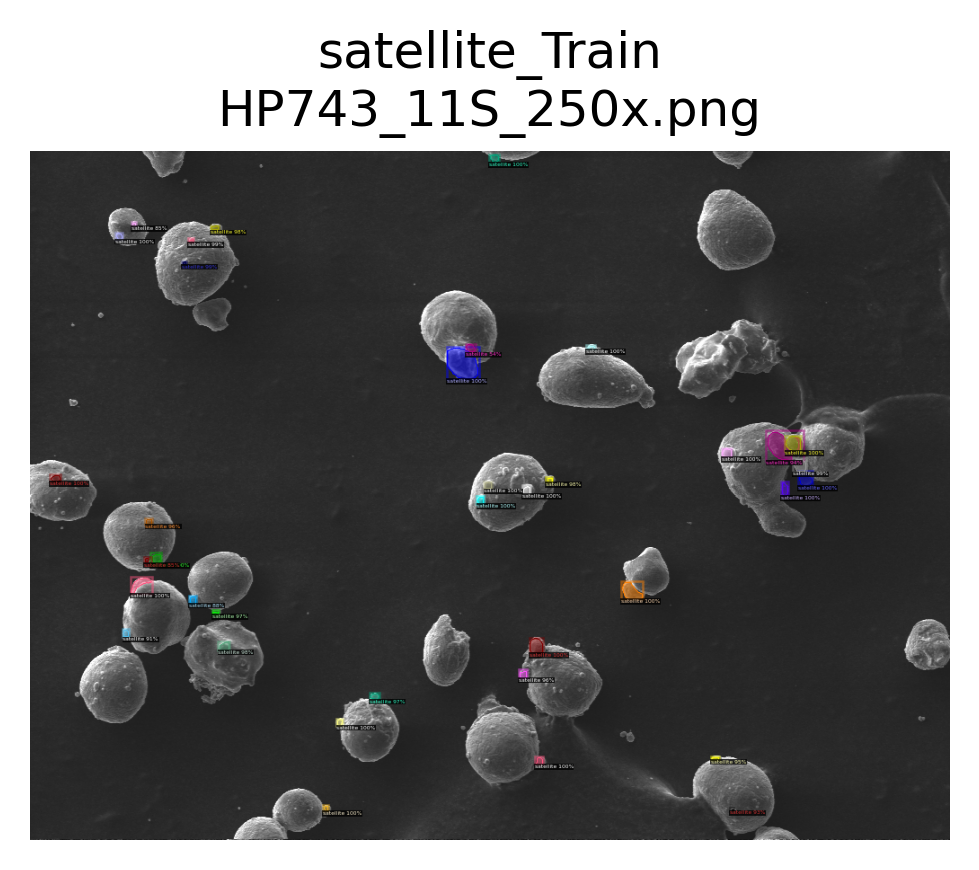

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_11S_250x.png
	num_instances: 37
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_6S_250x.png


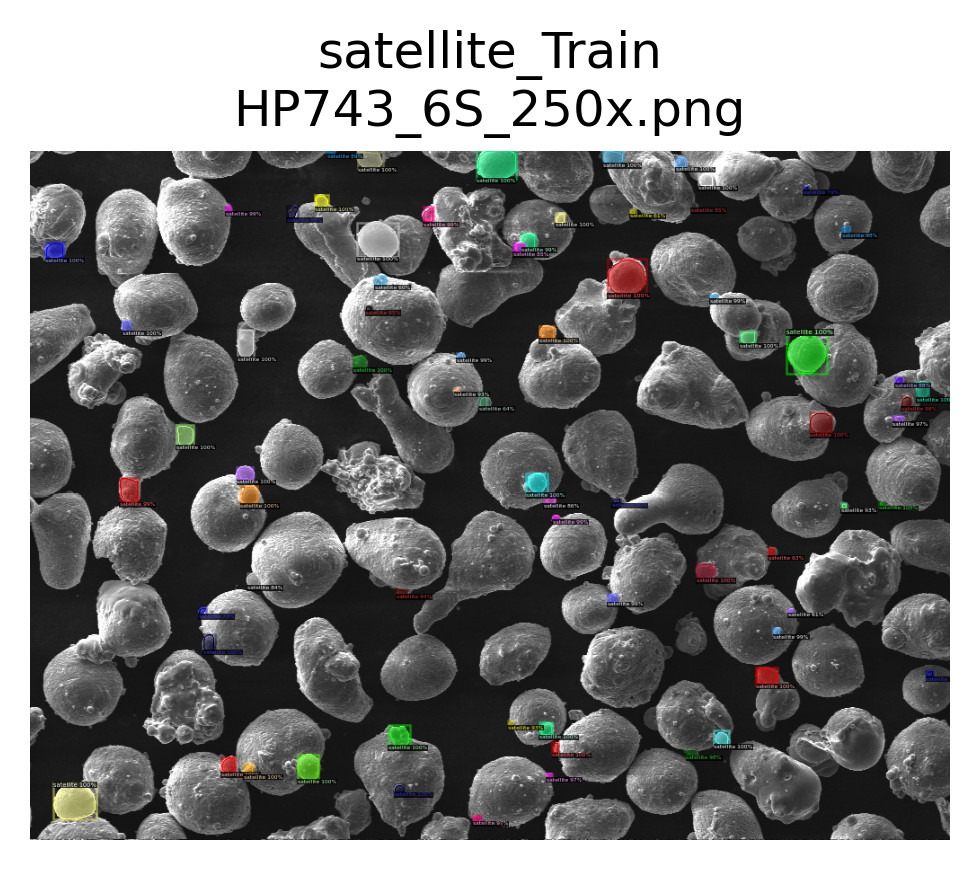

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_6S_250x.png
	num_instances: 71
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_02_SE1_1000X99.png


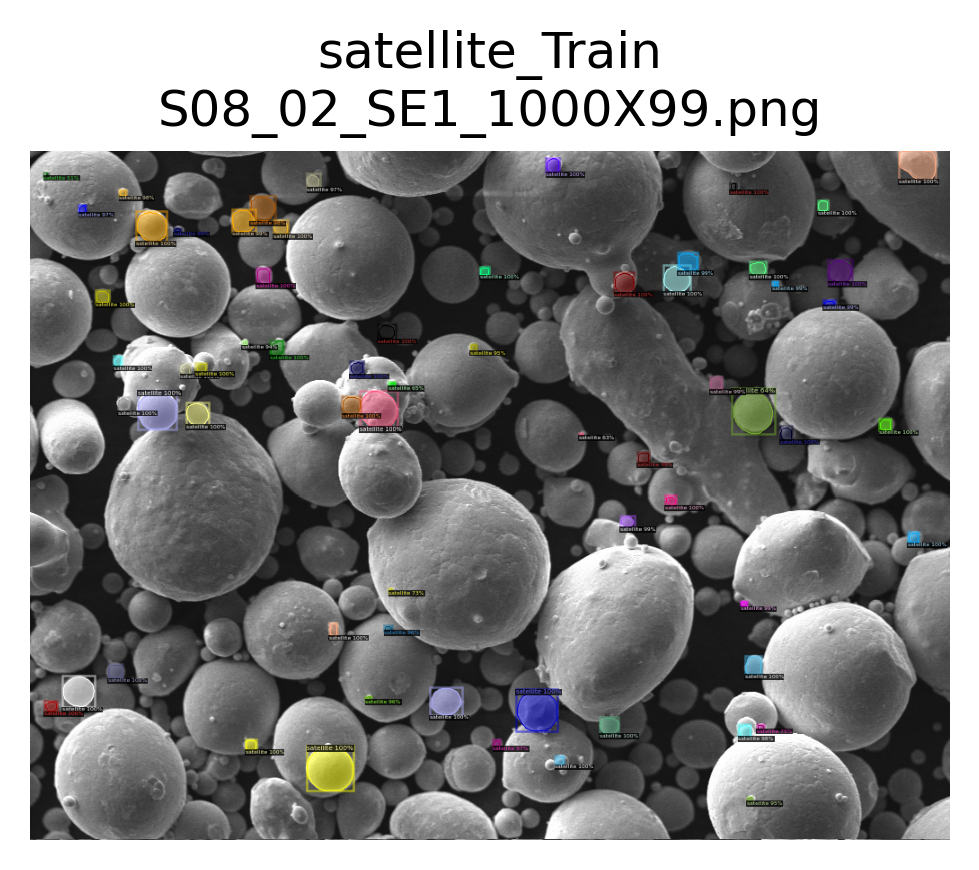

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_02_SE1_1000X99.png
	num_instances: 65
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_01_SE1_1000X94.png


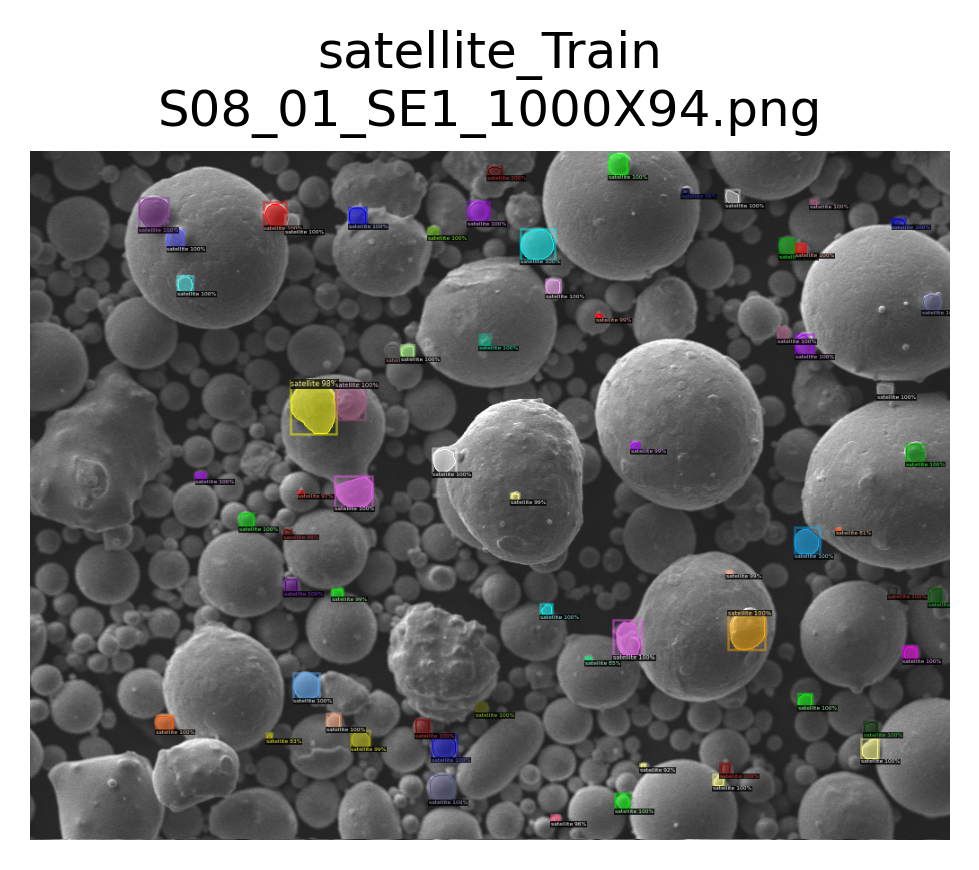

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_01_SE1_1000X94.png
	num_instances: 66
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_01_SE1_1000X45.png


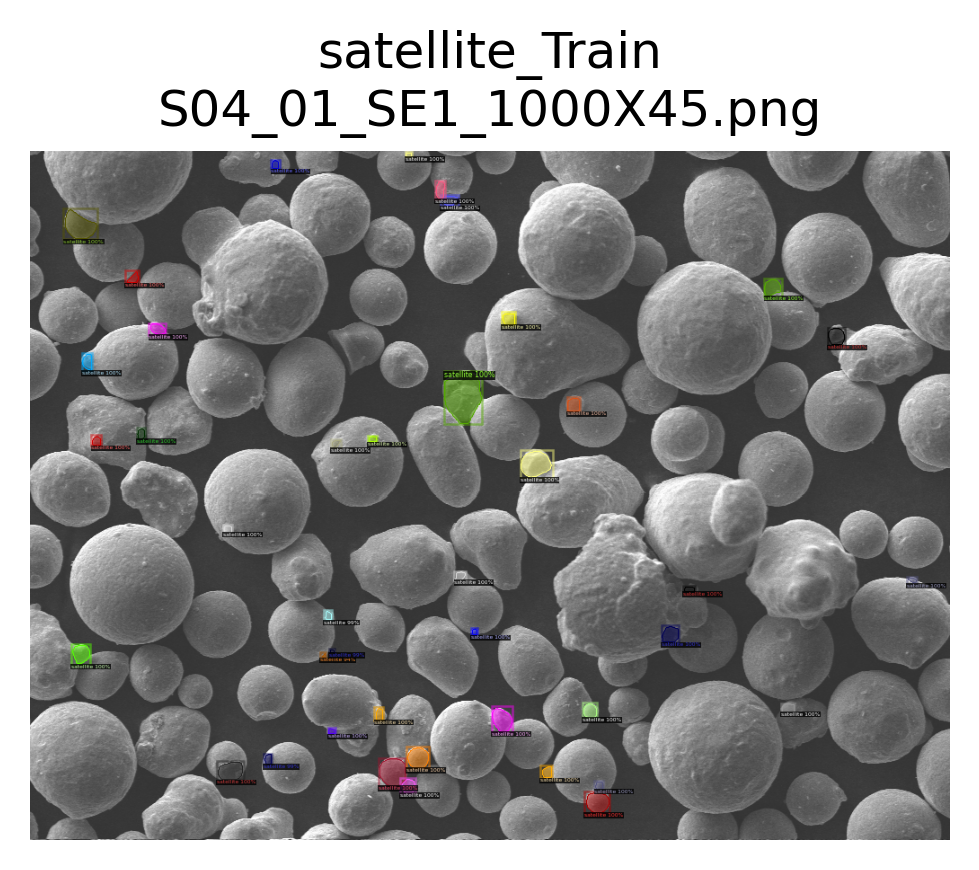

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_01_SE1_1000X45.png
	num_instances: 41
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_03_SE1_1000X53.png


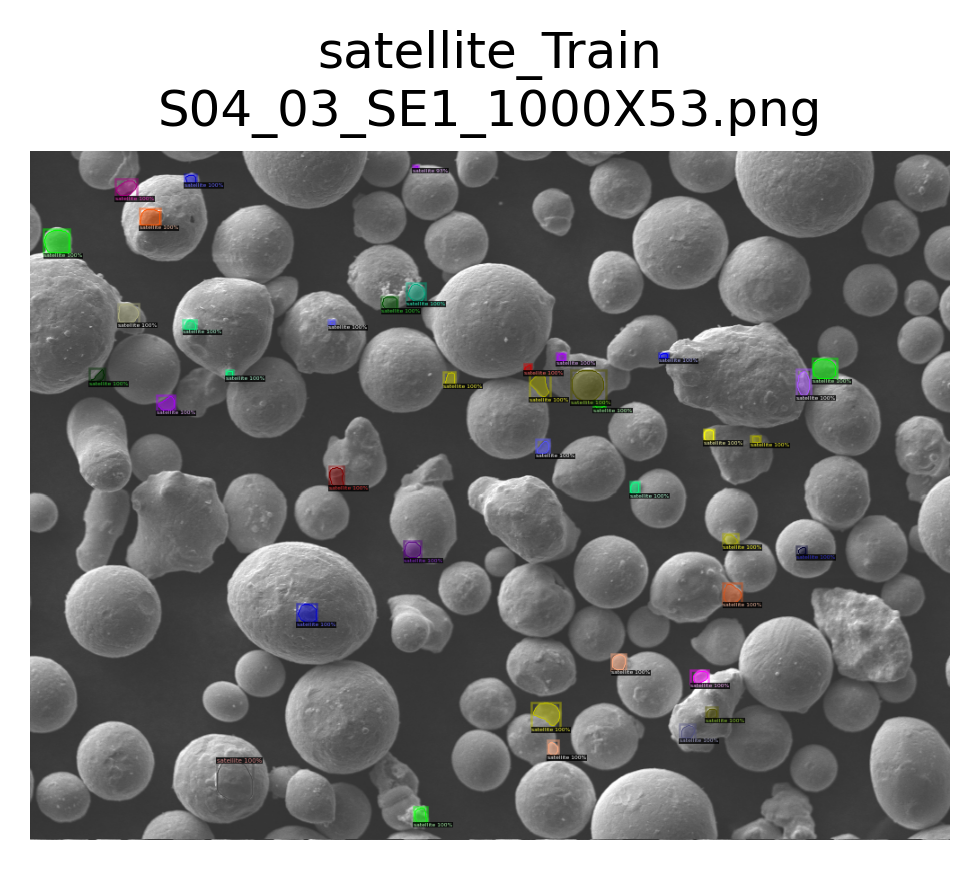

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_03_SE1_1000X53.png
	num_instances: 40
Dataset: satellite_Val
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png


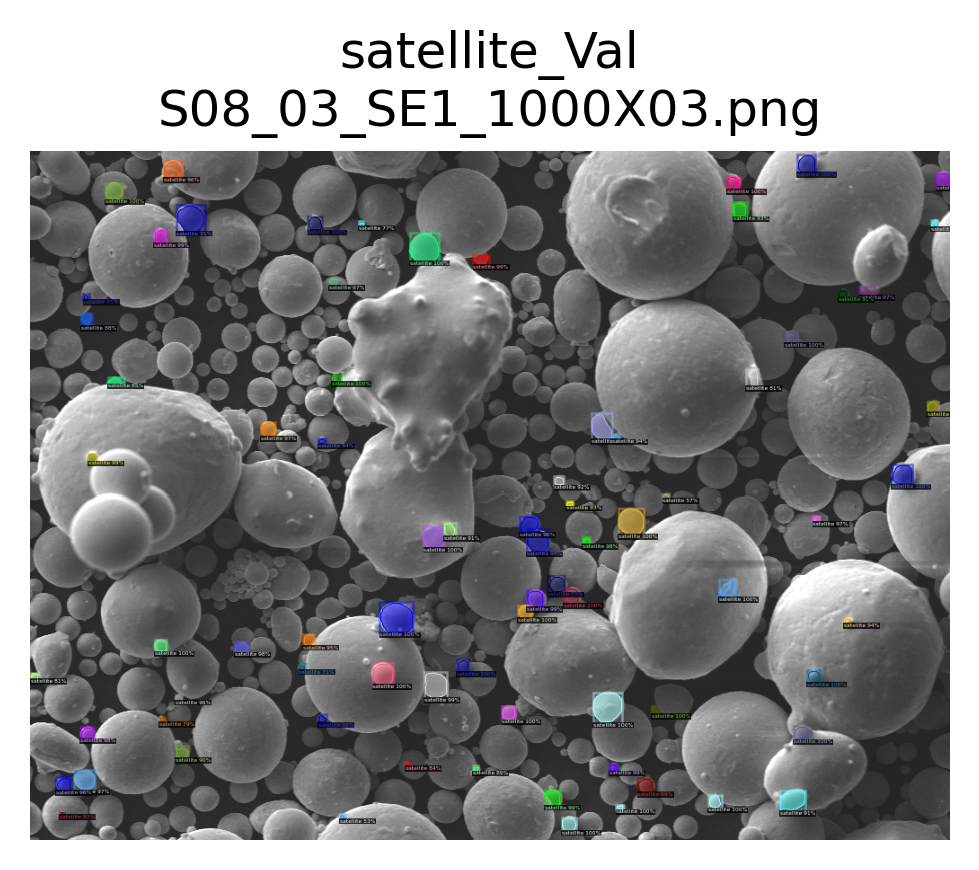

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S08_03_SE1_1000X03.png
	num_instances: 77
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png


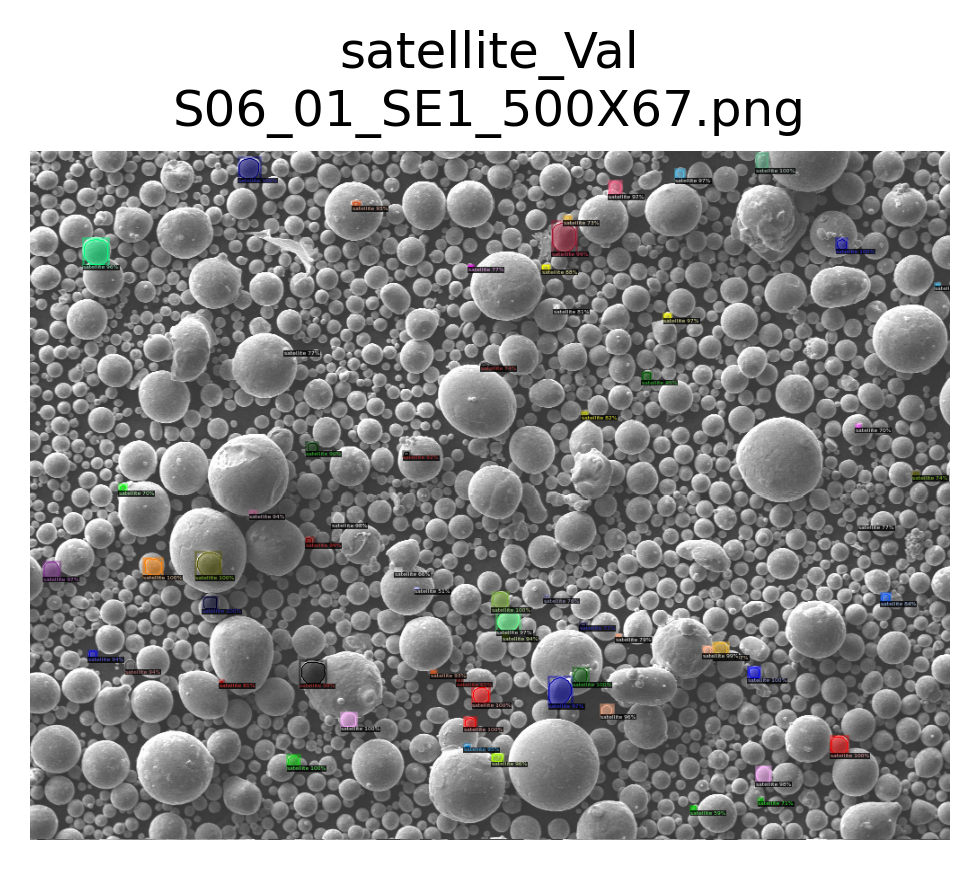

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S06_01_SE1_500X67.png
	num_instances: 62
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png


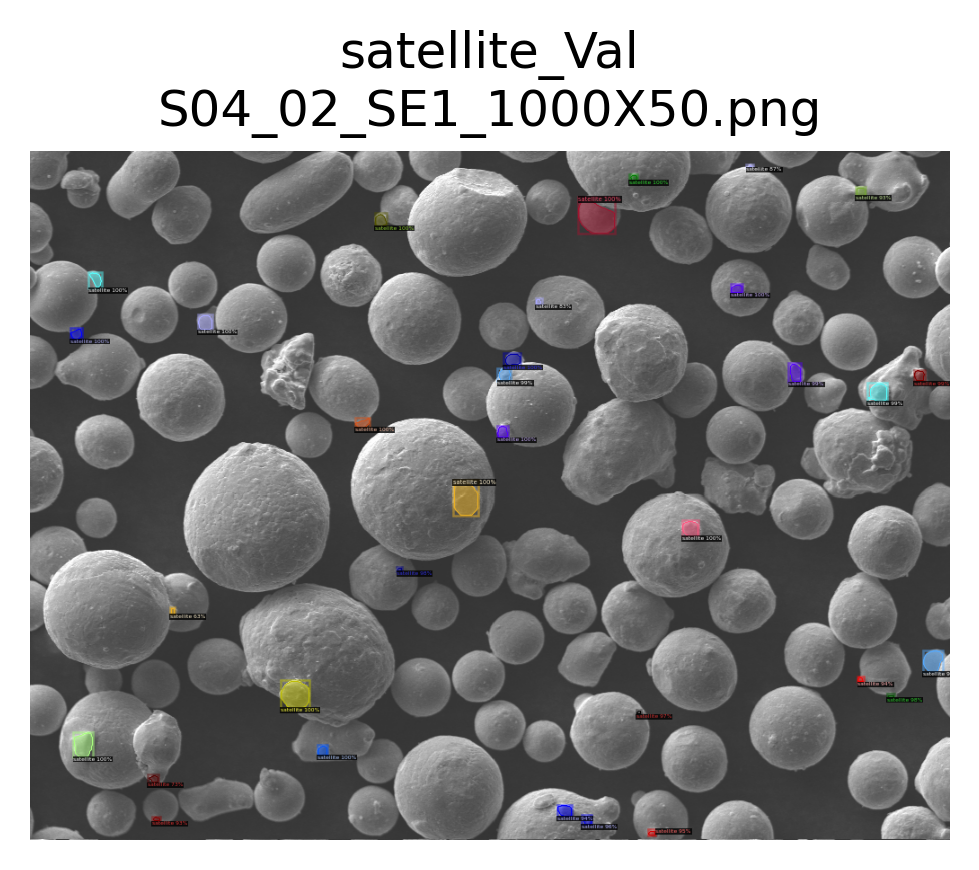

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S04_02_SE1_1000X50.png
	num_instances: 33
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png


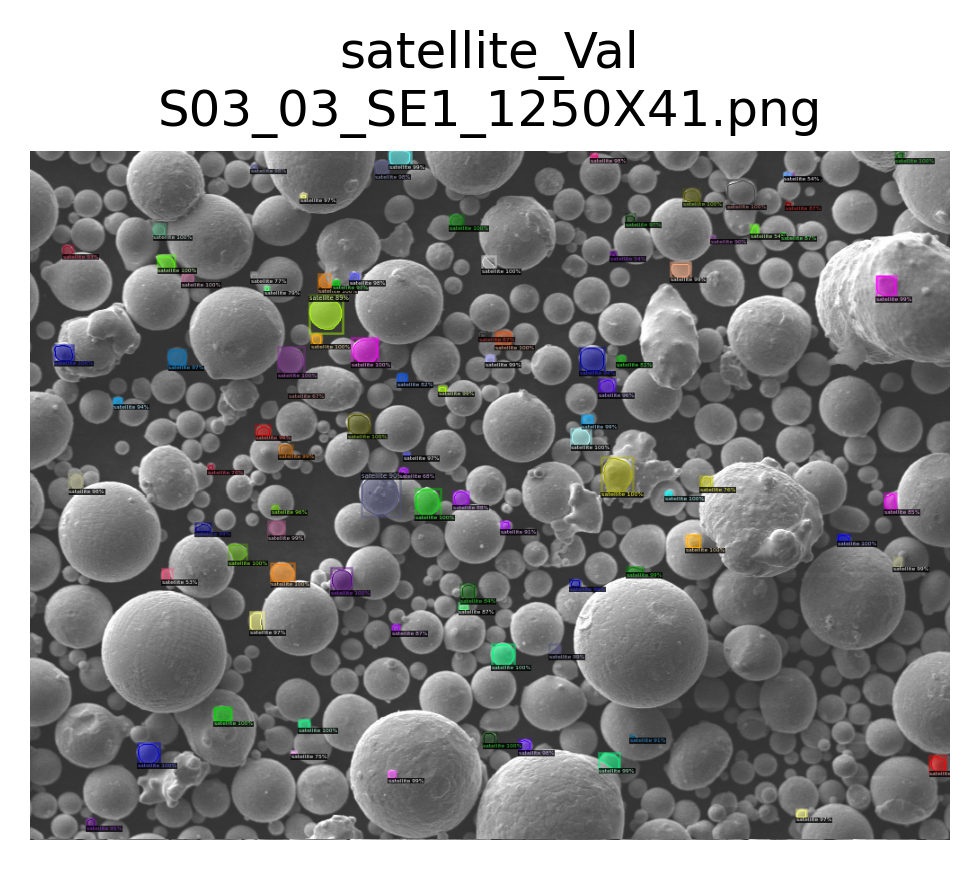

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S03_03_SE1_1250X41.png
	num_instances: 92
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png


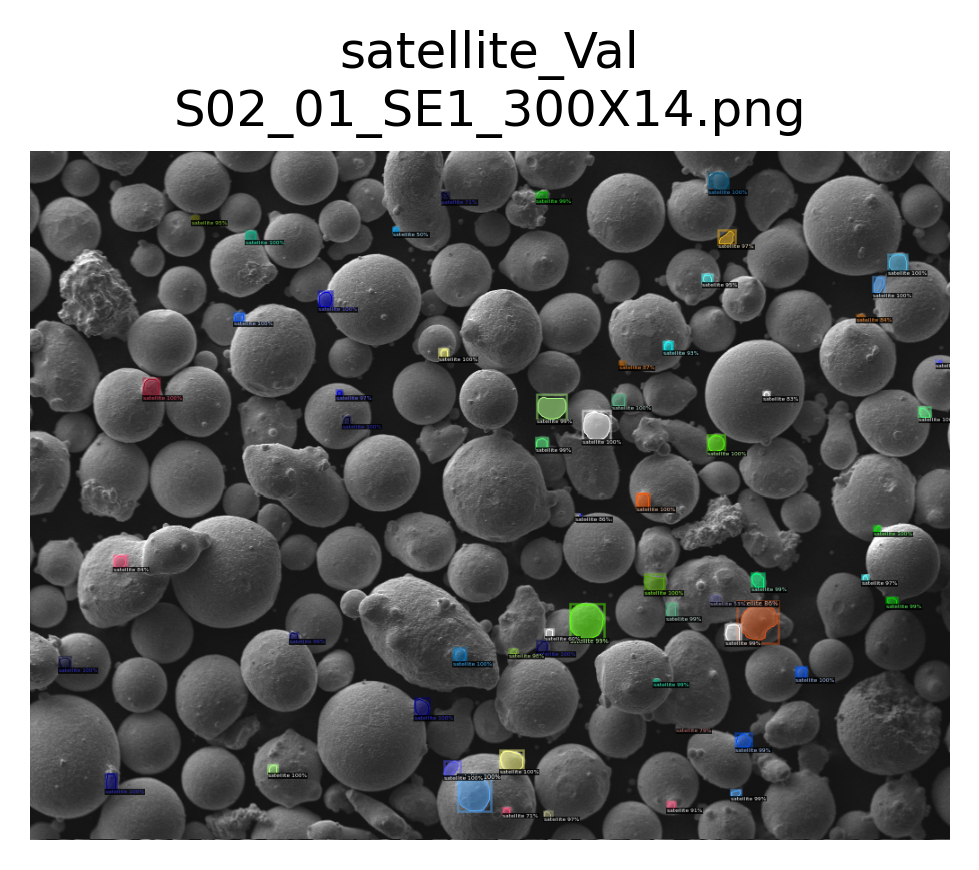

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/S02_01_SE1_300X14.png
	num_instances: 61
	File: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png


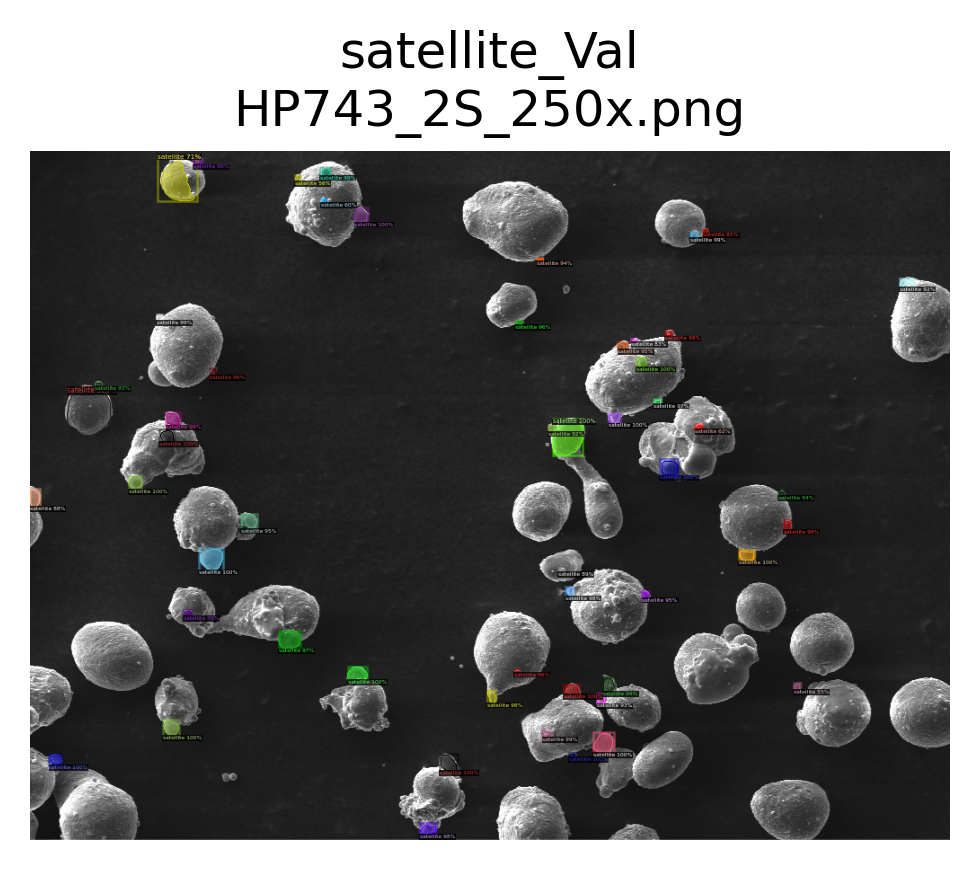

ddict info:
	path: batch_jobs/SALAS_Rep/../../../../../../../../ocean/projects/dmr200021p/sprice/initial_paper_complete_set/HP743_2S_250x.png
	num_instances: 53


In [16]:

results = []
for ds in cfg.DATASETS.TEST:
    print(f'Dataset: {ds}')
    for dd in DatasetCatalog.get(ds):
        print(f'\tFile: {dd["file_name"]}')
        img = cv2.imread(dd['file_name'])  # load image
        outs = predictor(img)  # run inference on image
        
        # format results for visualization and store for later
        results.append(data_utils.format_outputs(dd['file_name'], ds, outs))

        # visualize results
        visualize.display_ddicts(outs, None, ds, gt=False, img_path=dd['file_name'])

# save to disk
#with open(Path('Stage_results',f'{EXPERIMENT_NAME}-base_stage.pickle'), 'wb') as f:
#    pickle.dump(results, f)

## Generating predictions on new images is simple.
We will load a new image (not included in either dataset) and generate predictions.
Note that we do not have labels for this image and do not need to register it to a dataset.

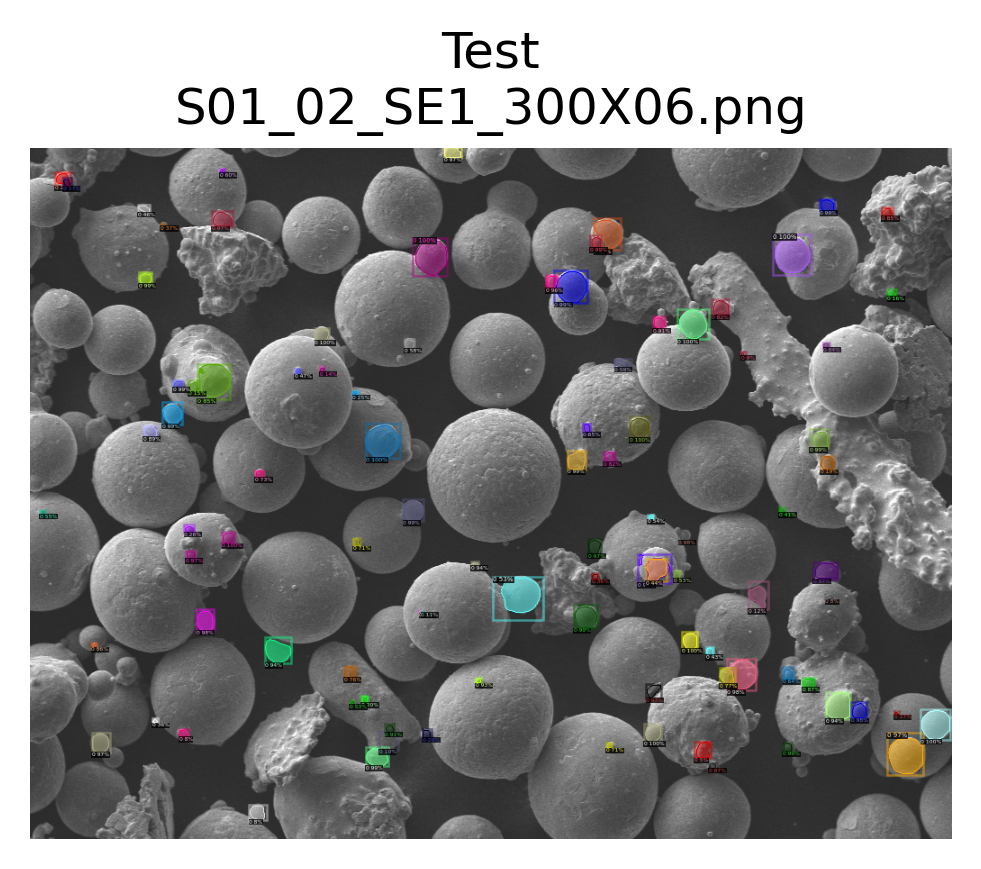

ddict info:
	path: ../data/SEM/S01_02_SE1_300X06.png
	num_instances: 95


In [11]:
img_path = Path('..', 'data','SEM', 'S01_02_SE1_300X06.png')
img = cv2.imread(str(img_path))
outs = predictor(img)
data_utils.format_outputs(img_path, dataset='test', pred=outs)
visualize.display_ddicts(ddict=outs,  # predictions to display
                                 outpath=None, dataset='Test',  # don't save figure
                                 gt=False,  # specifies format as model predictions
                                img_path=img_path)  # path to image
